# Лабораторная работа №4. Семантическая сегментация изображений
Реализация модели сверточной нейронной сети для классификации пикселей, принадлежащих объектам.
В работе используется датасет COCO, расположенный по ссылке http://cocodataset.org/.
Модель натренирована классифицировать пиксели принадлежащие машинам, мотоциклам, самолетам, автобусам и поездам.
В качестве энкодера нейронной сети взята FPN с энкодером Resnet50.
Loss-функция - категориальная кросс-энтропия (categorical cross entropy).
Метрика - точность (accuracy).

## Задача
1. Натренировать сеть для классификации животных из датасета COCO. (10 классов + класс фона).
2. Перепишите класс Dataset. Добавьте легкую аугментацию изображений: зеркалирование изображения относительно вертикальной оси, случайная обрезка кадра.
3. Дописать код, чтобы при обучении давать оценку точности, полноты и F-меры для каждого класса модели. Информацию можно получить по ссылке https://habr.com/ru/company/ods/blog/328372/.

На основании точности, полноты и F-меры для каждого класса сделайте выводы о качестве построенной модели.

In [1]:
from torch.utils.data import DataLoader
from torchvision.datasets import CocoCaptions, CocoDetection
from torchvision import transforms
from torch import nn
from pycocotools import mask
import numpy as np
import segmentation_models_pytorch as smp
from torchvision.models.segmentation import fcn_resnet50
from datetime import datetime
import torch
from torch.utils import data
from PIL import Image
from albumentations import (
    RandomSizedCrop,
    HorizontalFlip,
    Compose, 
    PadIfNeeded)

import matplotlib.pyplot as plt
import os
from tqdm import trange, tqdm 
from torchsummary import summary
import re
import seaborn as sn
import pandas as pd
from sklearn.metrics import confusion_matrix
%matplotlib inline

In [2]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

# augmentation example

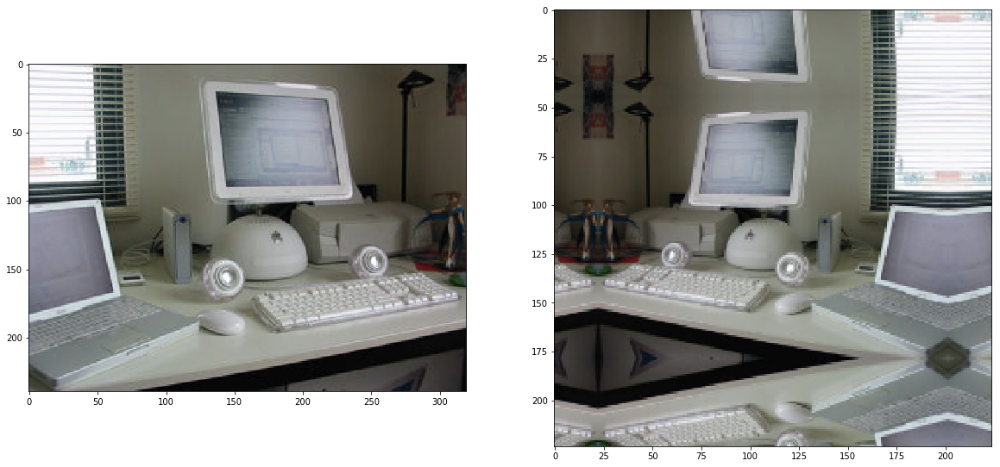

In [3]:
img1 = Image.open('../../../COCO/val2017/000000001503.jpg') # маленькое изображение

img1 = np.float32(np.array(img1)) / 255.
aug = Compose([PadIfNeeded(min_height=400, min_width=400), 
               RandomSizedCrop(min_max_height=(400, 400), height=224, width=224, p=1),
               HorizontalFlip(p=0.5)])
augmented = aug(image=img1)
img2 = augmented['image']


plt.figure(figsize=(20,10))
plt.subplot(121)
plt.imshow(img1)
plt.subplot(122)
plt.imshow(img2)
plt.show()

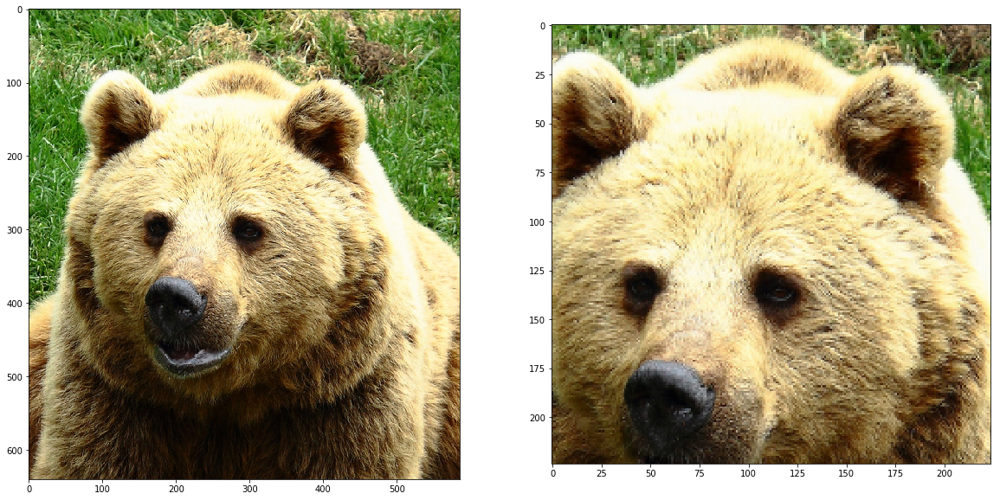

In [4]:
img1 = Image.open('../../../COCO/val2017/000000000285.jpg') # большое изображение
img1 = np.float32(np.array(img1)) / 255.
aug = Compose([PadIfNeeded(min_height=400, min_width=400), 
               RandomSizedCrop(min_max_height=(400, 400), height=224, width=224, p=1),
               HorizontalFlip(p=0.5)])
augmented = aug(image=img1)
img2 = augmented['image']


plt.figure(figsize=(20,10))
plt.subplot(121)
plt.imshow(img1)
plt.subplot(122)
plt.imshow(img2)
plt.show()

Реализация класса Dataset с чтением изображений и аннотаций в виде масок для тренировочного и валидационного датасетов.

In [5]:
class Dataset(CocoDetection):
    def __init__(self, root, annFile, subset='train', train_part=0.8):
        super().__init__(root, annFile, transforms=None, transform=None, target_transform=None)
        
        cat_names = ['bird',
                     'dog',
                     'sheep',
                     'elephant',
                     'zebra',
                     'giraffe',
                     'bear',
                     'cow',
                     'horse',
                     'cat'
                    ]
        
        cats = self.coco.loadCats(self.coco.getCatIds(cat_names))
        
        ids = []
        self.id_to_class, self.class_to_name = dict(), dict()
        self.id_to_class[0] = 0
        self.class_to_name[0] = 'background'
        for it, cat in enumerate(cats):
            self.id_to_class[cat['id']] = it+1
            self.class_to_name[it+1] = cat['name']
            
            ids.append(self.coco.getImgIds(catIds=[cat['id']]))
        self.ids = sum(ids, [])
#         self.ids = self.ids[:16]
        np.random.seed(1)
        np.random.shuffle(self.ids)
        if subset == 'train':
            self.ids = self.ids[:int(len(self.ids) * train_part)]
        elif subset == 'valid':
            self.ids = self.ids[int(len(self.ids) * train_part):]
            
    def num_classes(self):
        return len(self.id_to_class)
        
    def __getitem__(self, index):

        img, ann = super().__getitem__(index)
        width, height = img.size[:2]

        msk = np.zeros((height, width), dtype=np.uint8)
        for i, it in enumerate(ann):
            if it['category_id'] in self.id_to_class.keys():
                compressed_rle = mask.frPyObjects(it['segmentation'], height, width)
                bw = mask.decode(compressed_rle)

                if len(bw.shape) == 3:
                    bw = np.sum(bw, axis=2)

                msk[np.where(bw != 0)] = self.id_to_class[it['category_id']]
        
        
        img = np.float32(np.array(img)) / 255.
        msk = np.array(msk)
        aug = Compose([PadIfNeeded(min_height=400, min_width=400), 
               RandomSizedCrop(min_max_height=(400, 400), height=224, width=224, p=1),
               HorizontalFlip(p=0.5)])
        augmented = aug(image=img, mask=msk)
        img = augmented['image']
        msk = augmented['mask']
        

        img = img.transpose((2, 0, 1))
        img = torch.from_numpy(img.copy())
        msk = torch.from_numpy(np.array(msk)).long()
              
        return img, msk, ann  

Создаем объекты класса Dataset для тренировки и валидации.

In [6]:
path_to_images = '../../../COCO/train2017'
path_to_anno = '../../../COCO/annotations/instances_train2017.json'
train_dataset = Dataset(path_to_images, path_to_anno, subset='train')
valid_dataset = Dataset(path_to_images, path_to_anno, subset='valid')

loading annotations into memory...
Done (t=25.28s)
creating index...
index created!
loading annotations into memory...
Done (t=69.20s)
creating index...
index created!


In [7]:
train_dataset.class_to_name

{0: 'background',
 1: 'bird',
 2: 'cat',
 3: 'dog',
 4: 'horse',
 5: 'sheep',
 6: 'cow',
 7: 'elephant',
 8: 'bear',
 9: 'zebra',
 10: 'giraffe'}

In [8]:
len(train_dataset), len(valid_dataset)

(20591, 5148)

Визуализируем результаты изображения и маски.

In [9]:
img, msk, ann = train_dataset[5]#5

In [10]:
for i in train_dataset.class_to_name:
    print(train_dataset.class_to_name[i], np.sum(msk.numpy() == i), ' pixels')

background 42803  pixels
bird 0  pixels
cat 7373  pixels
dog 0  pixels
horse 0  pixels
sheep 0  pixels
cow 0  pixels
elephant 0  pixels
bear 0  pixels
zebra 0  pixels
giraffe 0  pixels


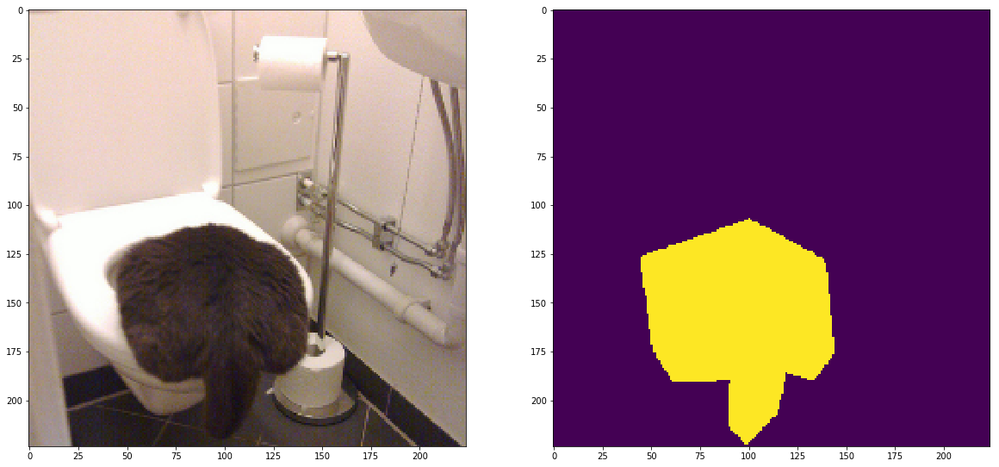

In [11]:
plt.figure(figsize=(20,10))
plt.subplot(121)
plt.imshow(img.numpy().transpose((1,2,0)))
plt.subplot(122)
plt.imshow(np.squeeze(msk.numpy()))
plt.show()

Создаем класс для рассчета и хранения средних значений величин. Далее будем таким образом считать средние значения функции потерь и метрик.

In [12]:
class AverageMeter(object):
    def __init__(self):
        self.initialized = False
        self.val = None
        self.avg = None
        self.sum = None
        self.count = None

    def initialize(self, val, weight):
        self.val = val
        self.avg = val
        self.sum = val * weight
        self.count = weight
        self.initialized = True

    def update(self, val, weight=1):
        if not self.initialized:
            self.initialize(val, weight)
        else:
            self.add(val, weight)

    def add(self, val, weight):
        #print("add val ", val, " weight " ,weight)
        self.val = val
        self.sum += val * weight
        self.count += weight
        self.avg = self.sum / self.count

    def value(self):
        return self.val

    def average(self):
        return self.avg

- outputs = pred torch.Size([16, 11, 224, 224])
- masks = label torch.Size([16, 224, 224])
### TP TN FP FN 

In [13]:
# TP - пересечение предсказанного класса с действительным классом
def per_class_TP(preds, label):
    classes = []
    for i in train_dataset.class_to_name:
        pred_class = (preds == i).long()
        true_class = (label == i).long()
        TP = torch.sum(pred_class * true_class)
        classes.append(TP)
    return torch.stack(classes).float()

# TN - пересение предсказанных остальных классов (не этого класса) с действительными остальными классами.
def per_class_TN(preds, label): 
    classes = []
    for i in train_dataset.class_to_name:
        pred_not_class = (preds != i).long()
        not_true_class = (label != i).long()
        TN = torch.sum(pred_not_class * not_true_class)
        classes.append(TN)
    return torch.stack(classes).float()

# FP - пересение действительного класса с предсказанными остальными классами.
def per_class_FP(preds, label):
    classes = []
    for i in train_dataset.class_to_name:
        pred_class = (preds == i).long()
        not_true_class = (label != i).long()
        FP = torch.sum(pred_class * not_true_class)
        classes.append(FP)
    return torch.stack(classes).float()

# FN - пересечение действительного класса с предсказанными не классами. классами.
def per_class_FN(preds, label):
    classes = []
    for i in train_dataset.class_to_name:
        pred_not_class = (preds != i).long()
        true_class = (label == i).long()
        FN = torch.sum(pred_not_class * true_class)
        classes.append(FN)
    return torch.stack(classes).float()

In [14]:
def pixel_acc(pred, label):
    _, preds = torch.max(pred, dim=1)
    valid = (label >= 0).long()
    acc_sum = torch.sum(valid * (preds == label).long())
    pixel_sum = torch.sum(valid)
    acc = acc_sum.float() / (pixel_sum.float() + 1e-10)
    return acc

In [15]:
def per_class_pixel_acc(pred, label):
    _, preds = torch.max(pred, dim=1)
    TP = per_class_TP(preds, label)
    TN = per_class_TN(preds, label)
    FP = per_class_FP(preds, label)
    FN = per_class_FN(preds, label)
    accuracy =(TP+TN)/(TP+TN+FP+FN+ 1e-10)
    return accuracy

def per_class_pixel_precision(pred, label):
    _, preds = torch.max(pred, dim=1)
    TP = per_class_TP(preds, label)
    FP = per_class_FP(preds, label)
    precision =TP/(TP+FP+ 1e-10)
    return precision

def per_class_pixel_recall(pred, label):
    _, preds = torch.max(pred, dim=1)
    TP = per_class_TP(preds, label)
    FN = per_class_FN(preds, label)
    recall =TP/(TP+FN+ 1e-10)
    return recall

def per_class_pixel_f1(pred, label):
    recall = per_class_pixel_recall(pred, label)
    precision = per_class_pixel_precision(pred, label)
    f1 = 2*precision*recall/(precision+recall+ 1e-10)
    return f1


# FPN

Создаем загрузчики данных для тренировки.

In [16]:
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
valid_loader = DataLoader(valid_dataset, batch_size=16, shuffle=True)

Создаем модели и определяем функцию потерь и метрики. Определяем шаги обучения.

In [17]:
model = smp.FPN(encoder_name='resnet50', classes=train_dataset.num_classes(), activation='softmax').to(device)

print('===> Try resume from checkpoint')

checkpoints=[f for f in os.listdir('../../../COCO/snapshots/') if 'fpn' in f]

if len(checkpoints) > 0:
    checkpoint = torch.load('../../../COCO/snapshots/'+sorted(checkpoints, key=lambda x: int(re.findall('fpn_(\d*)',x)[0]))[0])
    model.load_state_dict(checkpoint['state'])
    start_epoch = checkpoint['epoch']
    print('===> Load last checkpoint data')
else:
    start_epoch = 0
    print('===> Start from scratch')

criterion = nn.CrossEntropyLoss().to(device)
criterion.__name__= 'loss'

optimizer = torch.optim.Adam([
    {'params': model.decoder.parameters(), 'lr': 1e-4}, 

    {'params': model.encoder.parameters(), 'lr': 1e-5},  
])

fpn_train_confusion = np.zeros((11, 11))
fpn_val_confusion = np.zeros((11, 11))

===> Try resume from checkpoint
===> Start from scratch


### Обучение

In [18]:
epochs = 10

for epoch in range(epochs): 
    average_total_loss = AverageMeter()
    average_total_val_loss = AverageMeter()
    
    average_acc = AverageMeter()
    average_val_acc = AverageMeter()
    
    average_acc_class = [AverageMeter() for i in range(11)]
    average_val_acc_class = [AverageMeter() for i in range(11)]
    
    average_precision_class = [AverageMeter() for i in range(11)]
    average_val_precision_class = [AverageMeter() for i in range(11)]
    
    average_recall_class = [AverageMeter() for i in range(11)]
    average_val_recall_class = [AverageMeter() for i in range(11)]
    
    average_f1_class = [AverageMeter() for i in range(11)]
    average_val_f1_class = [AverageMeter() for i in range(11)]
    
    model.train(True)
    with tqdm(total=len(train_loader), 
              bar_format='{desc} epoch {postfix[0]} | {n_fmt}/{total_fmt} {elapsed}<{remaining} | {postfix[1]} : {postfix[2]:>2.4f} | {postfix[3]} : {postfix[4]:>2.4f} ', 
              postfix=[0, 'loss', 0, 'acc', 0], desc = 'Training') as t:
        t.postfix[0] = epoch + 1
        for data in train_loader:

            torch.cuda.empty_cache()
            inputs, masks, _ = data

            inputs=inputs.to(device)
            masks=masks.to(device)

            optimizer.zero_grad()
            outputs = model(inputs)

            loss = criterion(outputs, masks)
            acc = pixel_acc(outputs, masks)
            
            acc_classes = per_class_pixel_acc(outputs, masks)
            precision_classes = per_class_pixel_precision(outputs, masks)
            recall_classes = per_class_pixel_recall(outputs, masks)
            f1_classes = per_class_pixel_f1(outputs, masks)
            
            #print(acc_classes)
            #print(precision_classes)

            loss.backward()
            optimizer.step()


            average_total_loss.update(loss.data.item())
            average_acc.update(acc.data.item())
            
            for i in range(11):
                average_acc_class[i].update(acc_classes[i])#()
                average_precision_class[i].update(precision_classes[i])
                average_recall_class[i].update(recall_classes[i])
                average_f1_class[i].update(f1_classes[i])
            
            t.postfix[2] = average_total_loss.average()
            t.postfix[4] = average_acc.average()
            
            avg_list = []# print it
            precision_list = []
            recall_list = []
            f1_list = []
            for i in range(11):
                avg_list.append(average_acc_class[i].average().item())
                precision_list.append(average_precision_class[i].average().item())
                recall_list.append(average_recall_class[i].average().item())
                f1_list.append(average_f1_class[i].average().item())
                
            fpn_train_confusion += confusion_matrix(masks.detach().cpu().flatten(), np.argmax(outputs.detach().cpu(), axis=1).flatten(), list(range(11)))
            
            #t.postfix[6] = avg_list
            t.update()
        
    #print(avg_list)
    print('                           back   |bird   |cat    |dog    |horse  |sheep  |cow    |elephan|bear   |zebra  |giraffe|mean')
    print('per class acc           ', ["%0.2f" % i for i in avg_list]+["%0.2f" % np.mean(avg_list[1:])])
    print('per class precision     ', ["%0.2f" % i for i in precision_list]+["%0.2f" % np.mean(precision_list[1:])])
    print('per class recall        ', ["%0.2f" % i for i in recall_list]+["%0.2f" % np.mean(recall_list[1:])])
    print('per class f1            ', ["%0.2f" % i for i in f1_list]+["%0.2f" % np.mean(f1_list[1:])])
    #print(average_acc_class)
    
    # validation
    model.train(False)
    with tqdm(total=len(valid_loader), 
              bar_format='{desc} epoch {postfix[0]} {n_fmt}/{total_fmt} {elapsed}<{remaining} | {postfix[1]} : {postfix[2]:>2.4f} | {postfix[3]} : {postfix[4]:>2.4f}', 
              postfix=[0, 'val_loss', 0, 'val_acc', 0], desc = 'Validation') as t:
        t.postfix[0] = epoch + 1
        for data in valid_loader:
            torch.cuda.empty_cache()
            inputs, masks, _ = data

            inputs=inputs.to(device)
            masks=masks.to(device)

            outputs = model(inputs)

            loss = criterion(outputs, masks) 
            acc = pixel_acc(outputs, masks)
            acc_classes = per_class_pixel_acc(outputs, masks)
            precision_classes = per_class_pixel_precision(outputs, masks)
            recall_classes = per_class_pixel_recall(outputs, masks)
            f1_classes = per_class_pixel_f1(outputs, masks)
            
            

            average_total_val_loss.update(loss.data.item())
            average_val_acc.update(acc.data.item())
            for i in range(11):
                average_val_acc_class[i].update(acc_classes[i])#()
                average_val_precision_class[i].update(precision_classes[i])
                average_val_recall_class[i].update(recall_classes[i])
                average_val_f1_class[i].update(f1_classes[i])
            #average_val_acc_class
            
            t.postfix[2] = average_total_val_loss.average()
            t.postfix[4] = average_val_acc.average()
            
            avg_list = []# print it
            precision_list = []
            recall_list = []
            f1_list = []
            for i in range(11):
                avg_list.append(average_val_acc_class[i].average().item())
                precision_list.append(average_val_precision_class[i].average().item())
                recall_list.append(average_val_recall_class[i].average().item())
                f1_list.append(average_val_f1_class[i].average().item())
            
            fpn_val_confusion += confusion_matrix(masks.detach().cpu().flatten(), np.argmax(outputs.detach().cpu(), axis=1).flatten(), list(range(11)))
            
            t.update()
    print('                               back   |bird   |cat    |dog    |horse  |sheep  |cow    |elephan|bear   |zebra  |giraffe|mean')
    print('per class val acc           ', ["%0.2f" % i for i in avg_list]+["%0.2f" % np.mean(avg_list[1:])])
    print('per class val precision     ', ["%0.2f" % i for i in precision_list]+["%0.2f" % np.mean(precision_list[1:])])
    print('per class val recall        ', ["%0.2f" % i for i in recall_list]+["%0.2f" % np.mean(recall_list[1:])])
    print('per class val f1            ', ["%0.2f" % i for i in f1_list]+["%0.2f" % np.mean(f1_list[1:])])
    print('                                ⬛️      🦜️     😺     🐶      🦄      🐑     🐮      🐘     🐻      🦓     🦒')
    
    print('===> Saving models...')
    state = {
        'state': model.state_dict(),
        'epoch': epoch
    }
    torch.save(state, '../../../COCO/snapshots/fpn_{}.t7'.format(epoch))

Training epoch 1 | 1287/1287 1:59:28<00:00 | loss : 0.4005 | acc : 0.8891  


                           back   |bird   |cat    |dog    |horse  |sheep  |cow    |elephan|bear   |zebra  |giraffe|mean
per class acc            ['0.91', '0.99', '0.98', '0.98', '0.98', '0.99', '0.98', '0.99', '0.99', '0.99', '0.99', '0.99']
per class precision      ['0.93', '0.42', '0.68', '0.58', '0.50', '0.36', '0.39', '0.58', '0.33', '0.58', '0.60', '0.50']
per class recall         ['0.96', '0.34', '0.67', '0.53', '0.43', '0.30', '0.32', '0.55', '0.27', '0.57', '0.56', '0.46']
per class f1             ['0.94', '0.34', '0.65', '0.52', '0.43', '0.30', '0.32', '0.55', '0.28', '0.56', '0.55', '0.45']


Validation epoch 1 322/322 31:33<00:00 | val_loss : 0.2020 | val_acc : 0.9339


                               back   |bird   |cat    |dog    |horse  |sheep  |cow    |elephan|bear   |zebra  |giraffe|mean
per class val acc            ['0.94', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '1.00', '1.00', '0.99', '0.99']
per class val precision      ['0.96', '0.52', '0.83', '0.70', '0.60', '0.46', '0.52', '0.60', '0.35', '0.61', '0.72', '0.59']
per class val recall         ['0.97', '0.47', '0.69', '0.69', '0.56', '0.44', '0.45', '0.62', '0.37', '0.61', '0.67', '0.56']
per class val f1             ['0.96', '0.47', '0.74', '0.68', '0.56', '0.43', '0.46', '0.60', '0.35', '0.61', '0.69', '0.56']
                                ⬛️      🦜️     😺     🐶      🦄      🐑     🐮      🐘     🐻      🦓     🦒
===> Saving models...


Training epoch 2 | 1287/1287 1:47:41<00:00 | loss : 0.2211 | acc : 0.9289 


                           back   |bird   |cat    |dog    |horse  |sheep  |cow    |elephan|bear   |zebra  |giraffe|mean
per class acc            ['0.94', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '1.00', '1.00', '0.99', '0.99']
per class precision      ['0.96', '0.52', '0.77', '0.69', '0.62', '0.45', '0.50', '0.66', '0.38', '0.65', '0.72', '0.60']
per class recall         ['0.97', '0.44', '0.77', '0.66', '0.55', '0.39', '0.44', '0.64', '0.34', '0.64', '0.69', '0.56']
per class f1             ['0.96', '0.44', '0.75', '0.65', '0.56', '0.39', '0.44', '0.63', '0.35', '0.64', '0.69', '0.55']


Validation epoch 2 322/322 28:45<00:00 | val_loss : 0.1763 | val_acc : 0.9397


                               back   |bird   |cat    |dog    |horse  |sheep  |cow    |elephan|bear   |zebra  |giraffe|mean
per class val acc            ['0.95', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '1.00', '1.00', '0.99', '0.99']
per class val precision      ['0.96', '0.60', '0.75', '0.77', '0.65', '0.47', '0.59', '0.65', '0.39', '0.63', '0.76', '0.63']
per class val recall         ['0.97', '0.46', '0.81', '0.61', '0.60', '0.46', '0.47', '0.64', '0.37', '0.62', '0.72', '0.58']
per class val f1             ['0.97', '0.49', '0.77', '0.66', '0.60', '0.44', '0.49', '0.64', '0.36', '0.62', '0.73', '0.58']
                                ⬛️      🦜️     😺     🐶      🦄      🐑     🐮      🐘     🐻      🦓     🦒
===> Saving models...


Training epoch 3 | 1287/1287 1:43:55<00:00 | loss : 0.1865 | acc : 0.9378 


                           back   |bird   |cat    |dog    |horse  |sheep  |cow    |elephan|bear   |zebra  |giraffe|mean
per class acc            ['0.95', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '1.00', '1.00', '0.99', '0.99']
per class precision      ['0.96', '0.56', '0.79', '0.73', '0.65', '0.49', '0.55', '0.66', '0.39', '0.66', '0.71', '0.62']
per class recall         ['0.97', '0.46', '0.77', '0.69', '0.60', '0.43', '0.49', '0.65', '0.36', '0.65', '0.69', '0.58']
per class f1             ['0.97', '0.48', '0.76', '0.68', '0.61', '0.43', '0.49', '0.64', '0.37', '0.65', '0.69', '0.58']


Validation epoch 3 322/322 27:41<00:00 | val_loss : 0.1619 | val_acc : 0.9449


                               back   |bird   |cat    |dog    |horse  |sheep  |cow    |elephan|bear   |zebra  |giraffe|mean
per class val acc            ['0.95', '1.00', '0.99', '0.99', '0.99', '0.99', '0.99', '1.00', '1.00', '1.00', '0.99', '0.99']
per class val precision      ['0.97', '0.58', '0.81', '0.73', '0.65', '0.49', '0.59', '0.68', '0.38', '0.68', '0.72', '0.63']
per class val recall         ['0.97', '0.48', '0.77', '0.64', '0.60', '0.41', '0.54', '0.63', '0.39', '0.69', '0.71', '0.59']
per class val f1             ['0.97', '0.50', '0.78', '0.66', '0.59', '0.42', '0.54', '0.64', '0.38', '0.68', '0.71', '0.59']
                                ⬛️      🦜️     😺     🐶      🦄      🐑     🐮      🐘     🐻      🦓     🦒
===> Saving models...


Training epoch 4 | 1287/1287 1:43:36<00:00 | loss : 0.1659 | acc : 0.9435 


                           back   |bird   |cat    |dog    |horse  |sheep  |cow    |elephan|bear   |zebra  |giraffe|mean
per class acc            ['0.95', '1.00', '0.99', '0.99', '0.99', '0.99', '0.99', '0.99', '1.00', '1.00', '0.99', '0.99']
per class precision      ['0.96', '0.56', '0.80', '0.74', '0.66', '0.50', '0.56', '0.67', '0.40', '0.66', '0.73', '0.63']
per class recall         ['0.97', '0.46', '0.79', '0.70', '0.62', '0.45', '0.52', '0.66', '0.37', '0.65', '0.71', '0.59']
per class f1             ['0.97', '0.48', '0.79', '0.70', '0.62', '0.46', '0.51', '0.66', '0.37', '0.65', '0.71', '0.60']


Validation epoch 4 322/322 28:26<00:00 | val_loss : 0.1548 | val_acc : 0.9462


                               back   |bird   |cat    |dog    |horse  |sheep  |cow    |elephan|bear   |zebra  |giraffe|mean
per class val acc            ['0.95', '1.00', '0.99', '0.99', '0.99', '1.00', '0.99', '0.99', '1.00', '1.00', '1.00', '0.99']
per class val precision      ['0.97', '0.58', '0.79', '0.72', '0.65', '0.49', '0.54', '0.61', '0.38', '0.65', '0.74', '0.61']
per class val recall         ['0.97', '0.42', '0.78', '0.72', '0.62', '0.50', '0.54', '0.62', '0.37', '0.67', '0.76', '0.60']
per class val f1             ['0.97', '0.46', '0.78', '0.70', '0.61', '0.48', '0.52', '0.61', '0.37', '0.65', '0.74', '0.59']
                                ⬛️      🦜️     😺     🐶      🦄      🐑     🐮      🐘     🐻      🦓     🦒
===> Saving models...


Training epoch 5 | 1287/1287 1:45:11<00:00 | loss : 0.1520 | acc : 0.9472 


                           back   |bird   |cat    |dog    |horse  |sheep  |cow    |elephan|bear   |zebra  |giraffe|mean
per class acc            ['0.95', '1.00', '0.99', '0.99', '0.99', '1.00', '0.99', '0.99', '1.00', '1.00', '0.99', '0.99']
per class precision      ['0.97', '0.59', '0.81', '0.76', '0.67', '0.51', '0.58', '0.67', '0.41', '0.68', '0.73', '0.64']
per class recall         ['0.97', '0.48', '0.79', '0.72', '0.63', '0.46', '0.53', '0.66', '0.39', '0.67', '0.71', '0.60']
per class f1             ['0.97', '0.51', '0.79', '0.72', '0.63', '0.47', '0.53', '0.66', '0.39', '0.67', '0.71', '0.61']


Validation epoch 5 322/322 28:25<00:00 | val_loss : 0.1533 | val_acc : 0.9477


                               back   |bird   |cat    |dog    |horse  |sheep  |cow    |elephan|bear   |zebra  |giraffe|mean
per class val acc            ['0.96', '1.00', '0.99', '0.99', '0.99', '1.00', '0.99', '0.99', '1.00', '1.00', '1.00', '0.99']
per class val precision      ['0.97', '0.65', '0.80', '0.73', '0.66', '0.50', '0.56', '0.67', '0.39', '0.70', '0.74', '0.64']
per class val recall         ['0.98', '0.47', '0.74', '0.71', '0.62', '0.41', '0.54', '0.64', '0.36', '0.62', '0.71', '0.58']
per class val f1             ['0.97', '0.52', '0.76', '0.70', '0.62', '0.43', '0.53', '0.64', '0.36', '0.65', '0.72', '0.59']
                                ⬛️      🦜️     😺     🐶      🦄      🐑     🐮      🐘     🐻      🦓     🦒
===> Saving models...


Training epoch 6 | 1287/1287 1:48:31<00:00 | loss : 0.1402 | acc : 0.9505 


                           back   |bird   |cat    |dog    |horse  |sheep  |cow    |elephan|bear   |zebra  |giraffe|mean
per class acc            ['0.96', '1.00', '0.99', '0.99', '0.99', '1.00', '0.99', '0.99', '1.00', '1.00', '1.00', '0.99']
per class precision      ['0.97', '0.61', '0.82', '0.77', '0.68', '0.52', '0.59', '0.69', '0.41', '0.68', '0.73', '0.65']
per class recall         ['0.98', '0.51', '0.80', '0.73', '0.64', '0.47', '0.55', '0.68', '0.39', '0.67', '0.71', '0.62']
per class f1             ['0.97', '0.53', '0.80', '0.74', '0.64', '0.47', '0.55', '0.68', '0.40', '0.67', '0.72', '0.62']


Validation epoch 6 322/322 29:59<00:00 | val_loss : 0.1464 | val_acc : 0.9494


                               back   |bird   |cat    |dog    |horse  |sheep  |cow    |elephan|bear   |zebra  |giraffe|mean
per class val acc            ['0.96', '1.00', '0.99', '0.99', '0.99', '1.00', '0.99', '1.00', '1.00', '1.00', '1.00', '0.99']
per class val precision      ['0.97', '0.60', '0.82', '0.81', '0.68', '0.50', '0.54', '0.68', '0.39', '0.67', '0.77', '0.65']
per class val recall         ['0.98', '0.46', '0.81', '0.67', '0.60', '0.38', '0.54', '0.66', '0.37', '0.64', '0.70', '0.58']
per class val f1             ['0.97', '0.50', '0.81', '0.71', '0.62', '0.41', '0.53', '0.66', '0.37', '0.65', '0.73', '0.60']
                                ⬛️      🦜️     😺     🐶      🦄      🐑     🐮      🐘     🐻      🦓     🦒
===> Saving models...


Training epoch 7 | 62/1287 06:26<2:07:24 | loss : 0.1253 | acc : 0.9550 


KeyboardInterrupt: 

In [ ]:
print('===> Saving models...')
state = {'state': model.state_dict(),
         'epoch': epoch
        }
torch.save(state, '../../../COCO/snapshots/fpn_{}.t7'.format(epoch))

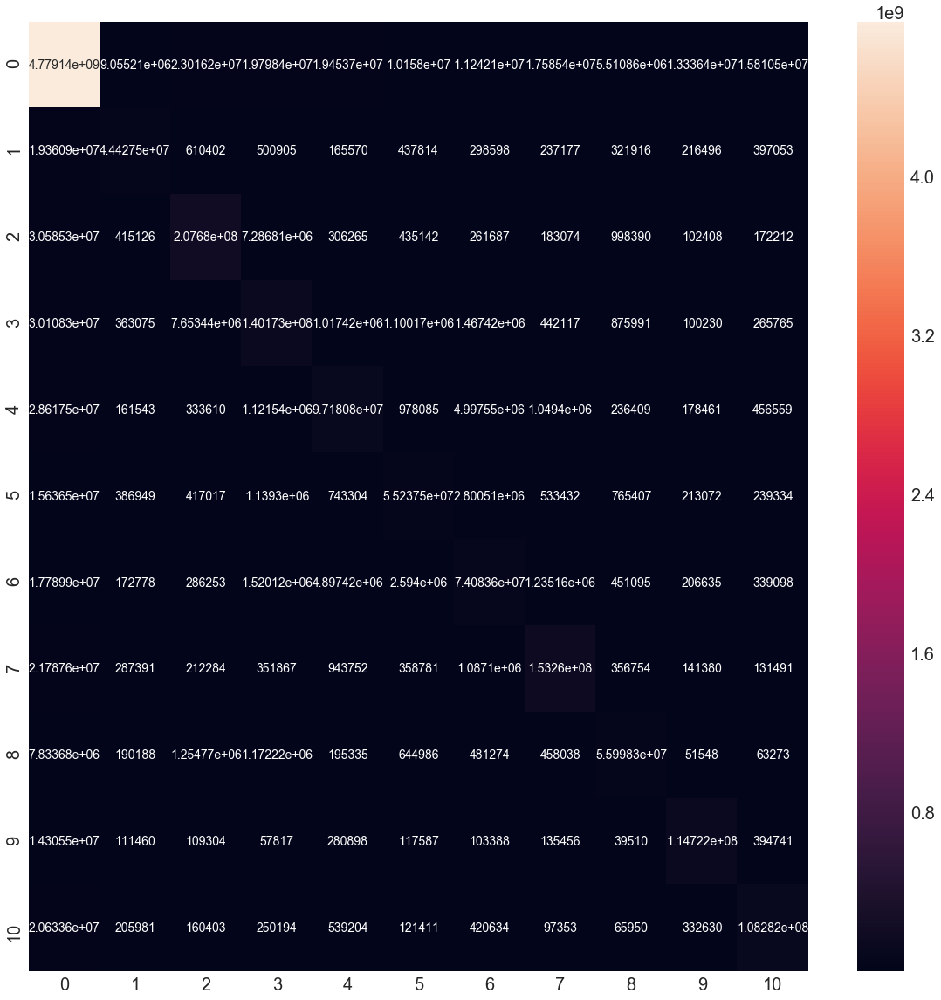

In [19]:
df_cm = pd.DataFrame(fpn_train_confusion, range(11), range(11))

plt.figure(figsize = (20,20))
sn.set(font_scale=2)
sn.heatmap(df_cm, annot=True,annot_kws={"size": 14}, fmt='g')

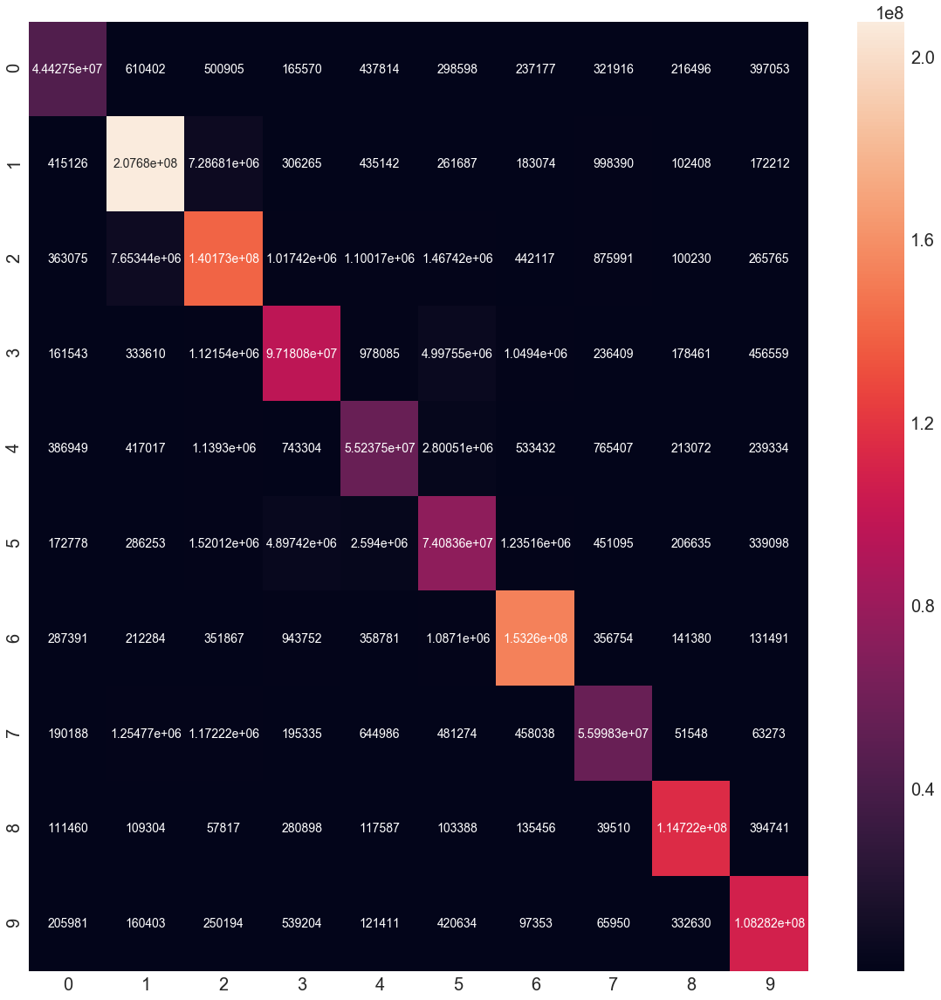

In [55]:
df_cm = pd.DataFrame(fpn_train_confusion[1:,1:], range(10), range(10))

plt.figure(figsize = (20,20))
sn.set(font_scale=2)
sn.heatmap(df_cm, annot=True,annot_kws={"size": 14}, fmt='g')

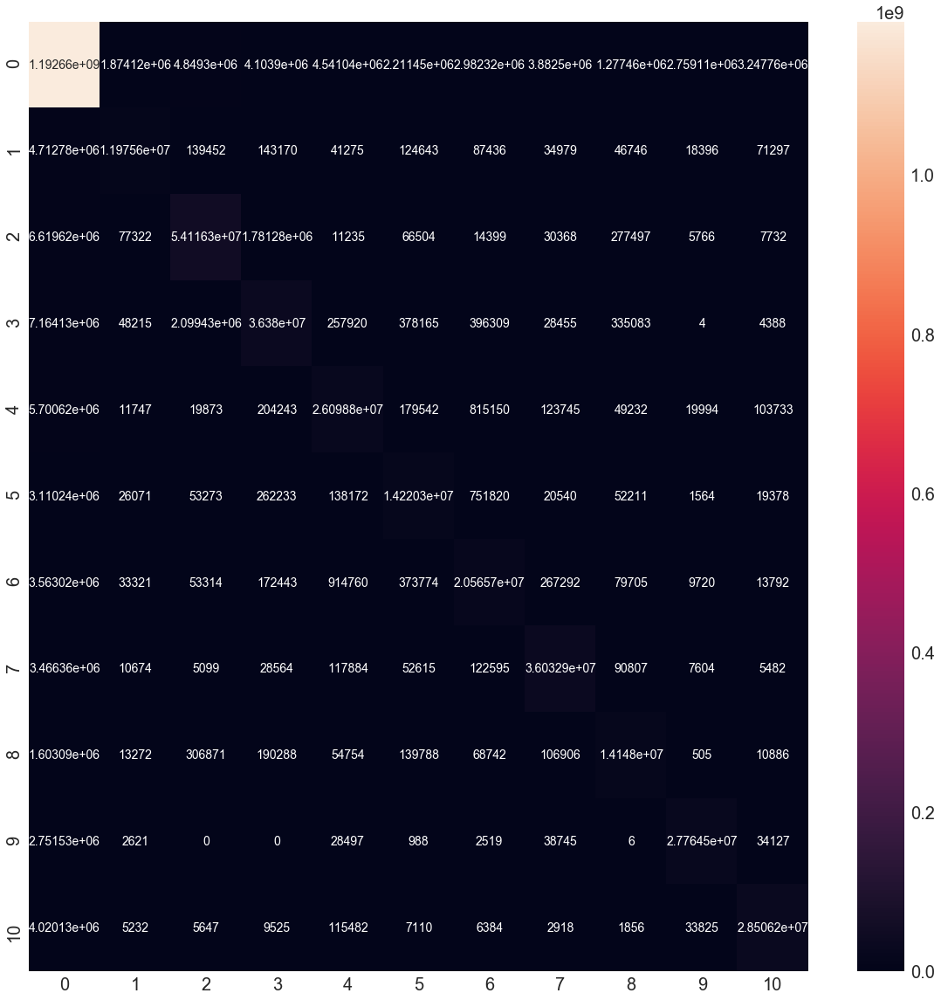

In [56]:
df_cm = pd.DataFrame(fpn_val_confusion, range(11), range(11))

plt.figure(figsize = (20,20))
sn.set(font_scale=2)
sn.heatmap(df_cm, annot=True,annot_kws={"size": 14}, fmt='g')

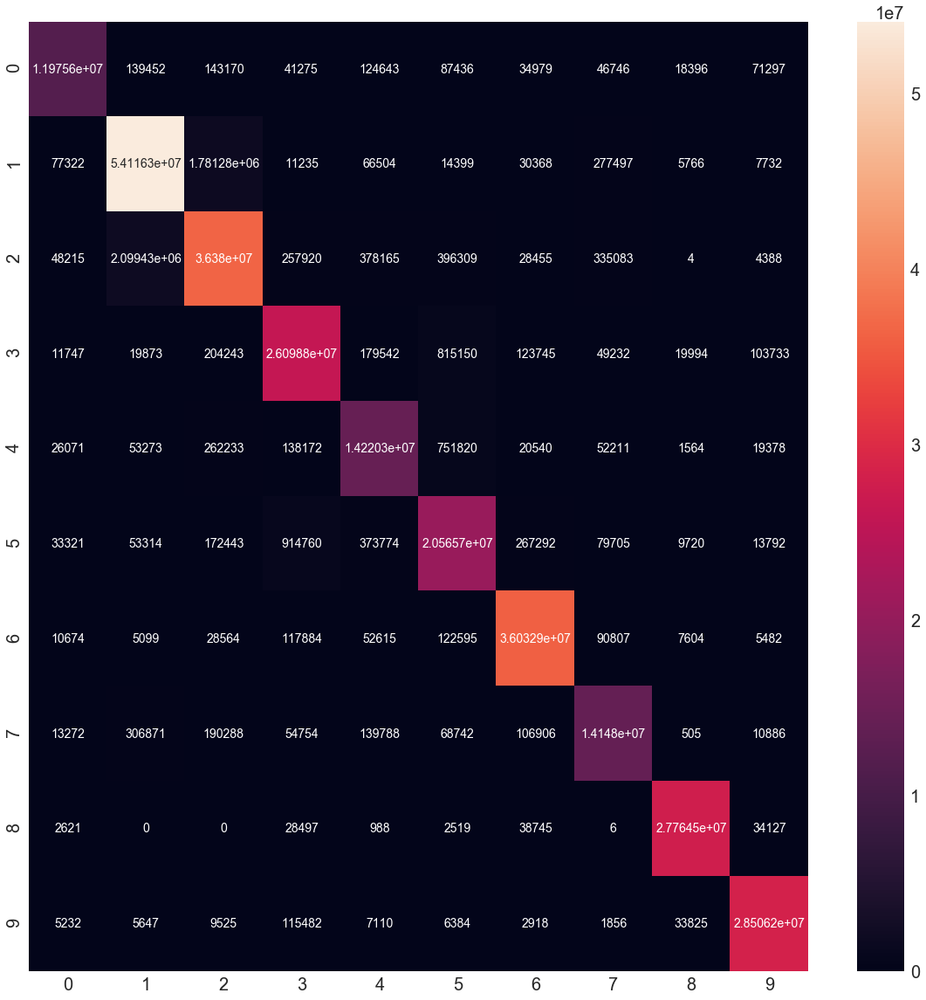

In [57]:
df_cm = pd.DataFrame(fpn_val_confusion[1:,1:], range(10), range(10))

plt.figure(figsize = (20,20))
sn.set(font_scale=2)
sn.heatmap(df_cm, annot=True,annot_kws={"size": 14}, fmt='g')

In [21]:
sn.set(font_scale=1)
sn.set_style("whitegrid", {'axes.grid' : False})

In [40]:
fpn_train_confusion.tofile('../../../COCO/snapshots/fpn_train_confusion.dat')
fpn_val_confusion.tofile('../../../COCO/snapshots/fpn_val_confusion.dat')

# FCN

Создаем загрузчики данных для тренировки.

In [ ]:
train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True)
valid_loader = DataLoader(valid_dataset, batch_size=1, shuffle=True)

Создаем модели и определяем функцию потерь и метрики. Определяем шаги обучения.

In [ ]:
class Net(nn.Module): 
    def __init__(self):
        super(Net, self).__init__()
#         self.net = deeplabv3_resnet50()
        self.net = fcn_resnet50()
        self.net.classifier[4] = nn.Conv2d(512, 81, kernel_size=(1, 1), stride=(1, 1))

    def forward(self, x):
        x = self.net(x)
        return x['out']

In [ ]:
model = Net().to(device)

print('===> Try resume from checkpoint')

checkpoints=[f for f in os.listdir('../../../COCO/snapshots/') if 'fcn' in f]

if len(checkpoints) > 0:
    checkpoint = torch.load('../../../COCO/snapshots/'+sorted(checkpoints, key=lambda x: int(re.findall('fcn_(\d*)',x)[0]))[0])
    model.load_state_dict(checkpoint['state'])
    start_epoch = checkpoint['epoch']
    print('===> Load last checkpoint data')
else:
    start_epoch = 0
    print('===> Start from scratch')

criterion = nn.CrossEntropyLoss().to(device)
criterion.__name__= 'loss'

optimizer = torch.optim.Adam([
    {'params': [param for name, param in model.named_parameters() if name[-4:] == 'bias'],
     'lr': 2*1e-5},
    {'params': [param for name, param in model.named_parameters() if name[-4:] != 'bias'],
     'lr': 1e-5, 'weight_decay': 1e-4}
])

fcn_train_confusion = np.zeros((11, 11))
fcn_val_confusion = np.zeros((11, 11))

### Обучение

In [ ]:
epochs = 3

for epoch in range(epochs): 
    average_total_loss = AverageMeter()
    average_total_val_loss = AverageMeter()
    
    average_acc = AverageMeter()
    average_val_acc = AverageMeter()
    
    average_acc_class = [AverageMeter() for i in range(11)]
    average_val_acc_class = [AverageMeter() for i in range(11)]
    
    average_precision_class = [AverageMeter() for i in range(11)]
    average_val_precision_class = [AverageMeter() for i in range(11)]
    
    average_recall_class = [AverageMeter() for i in range(11)]
    average_val_recall_class = [AverageMeter() for i in range(11)]
    
    average_f1_class = [AverageMeter() for i in range(11)]
    average_val_f1_class = [AverageMeter() for i in range(11)]
    
    model.train(True)
    with tqdm(total=len(train_loader), 
              bar_format='{desc} epoch {postfix[0]} | {n_fmt}/{total_fmt} {elapsed}<{remaining} | {postfix[1]} : {postfix[2]:>2.4f} | {postfix[3]} : {postfix[4]:>2.4f} ', 
              postfix=[0, 'loss', 0, 'acc', 0], desc = 'Training') as t:
        t.postfix[0] = epoch + 1
        for data in train_loader:

            torch.cuda.empty_cache()
            inputs, masks, _ = data

            inputs=inputs.to(device)
            masks=masks.to(device)

            optimizer.zero_grad()
            outputs = model(inputs)

            loss = criterion(outputs, masks)
            acc = pixel_acc(outputs, masks)
            
            acc_classes = per_class_pixel_acc(outputs, masks)
            precision_classes = per_class_pixel_precision(outputs, masks)
            recall_classes = per_class_pixel_recall(outputs, masks)
            f1_classes = per_class_pixel_f1(outputs, masks)
            
            #print(acc_classes)
            #print(precision_classes)

            loss.backward()
            optimizer.step()


            average_total_loss.update(loss.data.item())
            average_acc.update(acc.data.item())
            
            for i in range(11):
                average_acc_class[i].update(acc_classes[i])#()
                average_precision_class[i].update(precision_classes[i])
                average_recall_class[i].update(recall_classes[i])
                average_f1_class[i].update(f1_classes[i])
            
            t.postfix[2] = average_total_loss.average()
            t.postfix[4] = average_acc.average()
            
            avg_list = []# print it
            precision_list = []
            recall_list = []
            f1_list = []
            for i in range(11):
                avg_list.append(average_acc_class[i].average().item())
                precision_list.append(average_precision_class[i].average().item())
                recall_list.append(average_recall_class[i].average().item())
                f1_list.append(average_f1_class[i].average().item())
            #t.postfix[6] = avg_list
            
            fcn_train_confusion += confusion_matrix(masks.detach().cpu().flatten(), np.argmax(outputs.detach().cpu(), axis=1).flatten(), list(range(11)))
            
            t.update()
        
    #print(avg_list)
    print('                           back   |bird   |cat    |dog    |horse  |sheep  |cow    |elephan|bear   |zebra  |giraffe|mean')
    print('per class acc           ', ["%0.2f" % i for i in avg_list]+["%0.2f" % np.mean(avg_list[1:])])
    print('per class precision     ', ["%0.2f" % i for i in precision_list]+["%0.2f" % np.mean(precision_list[1:])])
    print('per class recall        ', ["%0.2f" % i for i in recall_list]+["%0.2f" % np.mean(recall_list[1:])])
    print('per class f1            ', ["%0.2f" % i for i in f1_list]+["%0.2f" % np.mean(f1_list[1:])])
    #print(average_acc_class)
    
    # validation
    model.train(False)
    with tqdm(total=len(valid_loader), 
              bar_format='{desc} epoch {postfix[0]} {n_fmt}/{total_fmt} {elapsed}<{remaining} | {postfix[1]} : {postfix[2]:>2.4f} | {postfix[3]} : {postfix[4]:>2.4f}', 
              postfix=[0, 'val_loss', 0, 'val_acc', 0], desc = 'Validation') as t:
        t.postfix[0] = epoch + 1
        for data in valid_loader:
            torch.cuda.empty_cache()
            inputs, masks, _ = data

            inputs=inputs.to(device)
            masks=masks.to(device)

            outputs = model(inputs)

            loss = criterion(outputs, masks) 
            acc = pixel_acc(outputs, masks)
            acc_classes = per_class_pixel_acc(outputs, masks)
            precision_classes = per_class_pixel_precision(outputs, masks)
            recall_classes = per_class_pixel_recall(outputs, masks)
            f1_classes = per_class_pixel_f1(outputs, masks)
            
            

            average_total_val_loss.update(loss.data.item())
            average_val_acc.update(acc.data.item())
            for i in range(11):
                average_val_acc_class[i].update(acc_classes[i])#()
                average_val_precision_class[i].update(precision_classes[i])
                average_val_recall_class[i].update(recall_classes[i])
                average_val_f1_class[i].update(f1_classes[i])
            #average_val_acc_class
            
            t.postfix[2] = average_total_val_loss.average()
            t.postfix[4] = average_val_acc.average()
            
            avg_list = []# print it
            precision_list = []
            recall_list = []
            f1_list = []
            for i in range(11):
                avg_list.append(average_val_acc_class[i].average().item())
                precision_list.append(average_val_precision_class[i].average().item())
                recall_list.append(average_val_recall_class[i].average().item())
                f1_list.append(average_val_f1_class[i].average().item())
                
            fcn_val_confusion += confusion_matrix(masks.detach().cpu().flatten(), np.argmax(outputs.detach().cpu(), axis=1).flatten(), list(range(11)))
                
            t.update()
    print('                               back   |bird   |cat    |dog    |horse  |sheep  |cow    |elephan|bear   |zebra  |giraffe|mean')
    print('per class val acc           ', ["%0.2f" % i for i in avg_list]+["%0.2f" % np.mean(avg_list[1:])])
    print('per class val precision     ', ["%0.2f" % i for i in precision_list]+["%0.2f" % np.mean(precision_list[1:])])
    print('per class val recall        ', ["%0.2f" % i for i in recall_list]+["%0.2f" % np.mean(recall_list[1:])])
    print('per class val f1            ', ["%0.2f" % i for i in f1_list]+["%0.2f" % np.mean(f1_list[1:])])
    print('                                ⬛️      🦜️     😺     🐶      🦄      🐑     🐮      🐘     🐻      🦓     🦒')
    
    print('===> Saving models...')
    state = {
        'state': model.state_dict(),
        'epoch': epoch
    }
    torch.save(state, '../../../COCO/snapshots/fcn_{}.t7'.format(epoch))

In [ ]:
print('===> Saving models...')
state = {'state': model.state_dict(),
         'epoch': epoch
        }
torch.save(state, '../../../COCO/snapshots/fcn_{}.t7'.format(epoch))

In [ ]:
df_cm = pd.DataFrame(fcn_train_confusion, range(11), range(11))

plt.figure(figsize = (20,20))
sn.set(font_scale=2)
sn.heatmap(df_cm, annot=True,annot_kws={"size": 14}, fmt='g')

In [ ]:
df_cm = pd.DataFrame(fcn_val_confusion, range(11), range(11))

plt.figure(figsize = (20,20))
sn.set(font_scale=2)
sn.heatmap(df_cm, annot=True,annot_kws={"size": 14}, fmt='g')

In [ ]:
sn.set(font_scale=1)
sn.set_style("whitegrid", {'axes.grid' : False})

### Визуальная оценка результатов
Все классы выглядят неплохо, если объект крупный. 

In [ ]:
fcn_models=[]

for file in ['.t7','.t7','.t7']:
    fcn_1 = Net().to(device)
    checkpoint = torch.load('../../../COCO/snapshots/'+file)
    fcn_1.load_state_dict(checkpoint['state'])
    fcn_1.eval()
    
    fcn_models.append([file,fcn_1])

In [41]:
fpn_models=[]

for file in ['fpn_0.t7','fpn_1.t7','fpn_2.t7','fpn_3.t7','fpn_4.t7','fpn_5.t7']:
    fpn_1 = smp.FPN(encoder_name='resnet50', classes=train_dataset.num_classes(), activation='softmax').to(device)
    checkpoint = torch.load('../../../COCO/snapshots/'+file)
    fpn_1.load_state_dict(checkpoint['state'])
    fpn_1.eval()
    
    fpn_models.append([file,fpn_1])

In [ ]:
fcn_models=[]

for file in ['semantic_1_27800.pt','semantic_2_59144.pt','semantic_3_59144.pt']:
    fcn_1=torch.load('../../../COCO/snapshots/'+file).to(device)
    fcn_1.eval()
    
    fcn_models.append([file,fcn_1])

In [23]:
def plot_val(i):
    img, msk, _ = valid_dataset[i]
    sm = nn.Softmax(dim=1)
    pred = sm(model(img.expand(1, -1,-1,-1).to(device)))
    _, max_pred = torch.max(pred, dim=1)
    plt.figure(figsize=(20,10))
    plt.subplot(131)
    plt.imshow(img.numpy().transpose((1,2,0)))
    plt.subplot(132)
    plt.imshow(np.squeeze(msk.numpy()))
    plt.subplot(133)
    plt.imshow(max_pred[0].detach().cpu().numpy())

In [24]:
model=fpn_models[-1][1]

# bird   

In [ ]:
plot_val(555)
plot_val(47)

# cat     

In [ ]:
plot_val(8)
plot_val(82)

# dog    

In [ ]:
plot_val(15)
plot_val(2)

# horse   

In [ ]:
plot_val(17)
plot_val(11)

# sheep   

In [ ]:
plot_val(4)
plot_val(81)

# cow     

In [ ]:
plot_val(75)
plot_val(88)

# elephant

In [ ]:
plot_val(19)
plot_val(24)

# bear    

In [ ]:
plot_val(13)
plot_val(60)

# zebra   

In [ ]:
plot_val(30)
plot_val(33)

# giraffe

In [ ]:
plot_val(5)
plot_val(9)

# Слишком сложное

In [ ]:
plot_val(41)
plot_val(42)
plot_val(74)
plot_val(98)

# Несколько классов

In [ ]:
plot_val(57)
plot_val(12)
plot_val(70)

In [37]:
def plot_val_model(i, title, mdls):
    img, msk, _ = valid_dataset[i]
    sm = nn.Softmax(dim=1)
    for mdl in mdls:
        print(title, mdl[0])
        pred = sm(mdl[1](img.expand(1, -1,-1,-1).to(device)))
        _, max_pred = torch.max(pred, dim=1)
        plt.figure(figsize=(20,10))
        plt.subplot(131)
        plt.imshow(img.numpy().transpose((1,2,0)))
        plt.subplot(132)
        plt.imshow(np.squeeze(msk.numpy()))
        plt.subplot(133)
        plt.imshow(max_pred[0].detach().cpu().numpy())
        plt.pause(0.1)

In [38]:
examples={
    47:'bird',
    8:'cat',
    2:'dog',    
    11:'horse',    
    81:'sheep',
    75:'cow',
    19:'elephant',    
    13:'bear',    
    30:'zebra',   
    9:'giraffe',

    74:'difficult',
    98:'difficult',
    
    57:'multiple classes',
    12:'multiple classes',
    70:'multiple classes',
}

# Прогресс FPN

bird fpn_0.t7


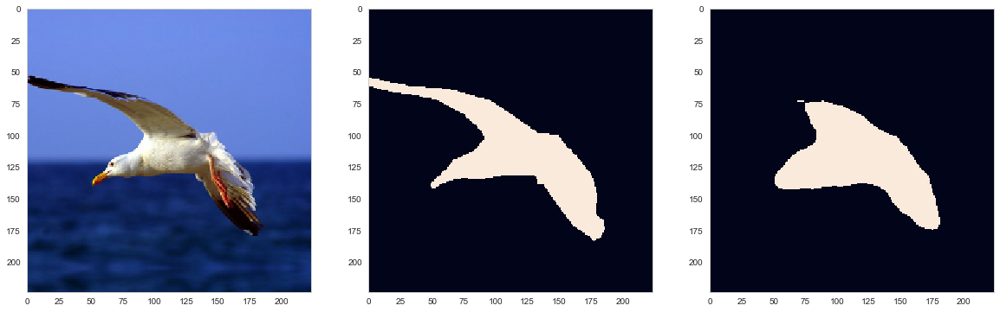

bird fpn_1.t7


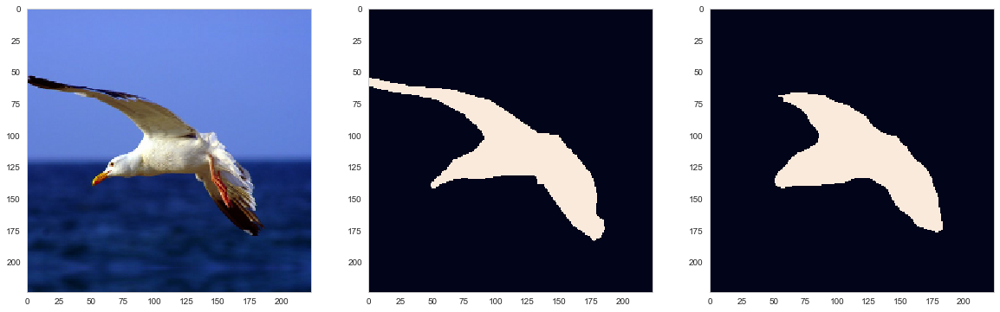

bird fpn_2.t7


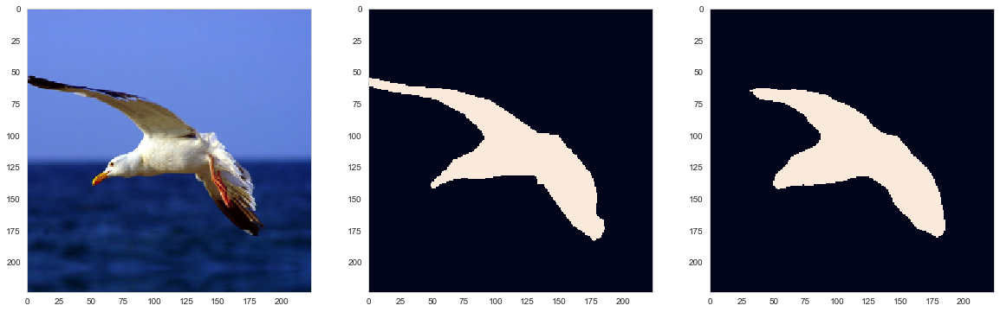

bird fpn_3.t7


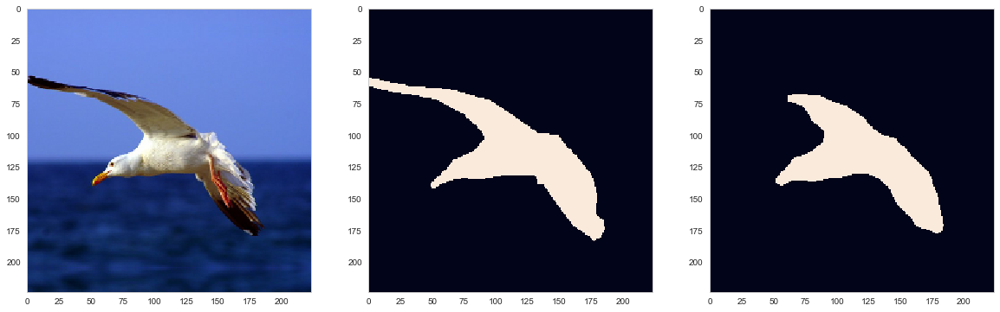

bird fpn_4.t7


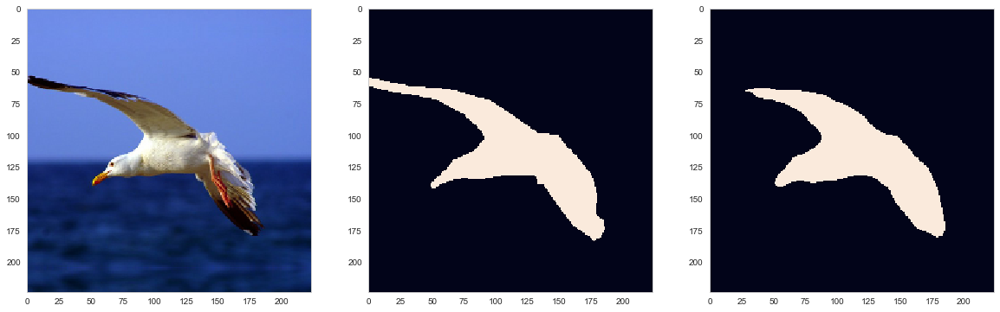

bird fpn_5.t7


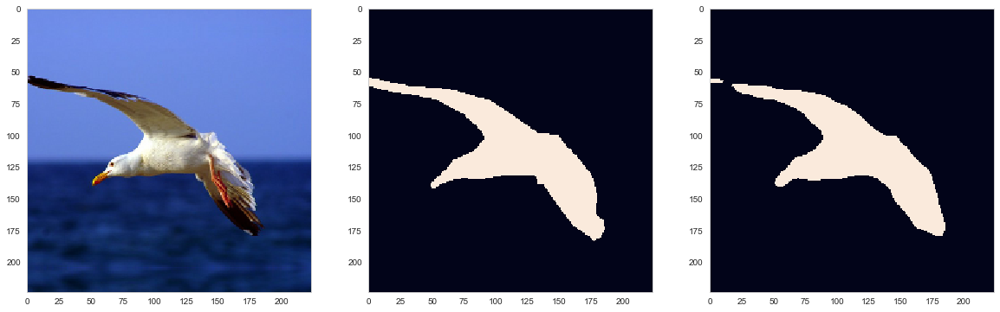

cat fpn_0.t7


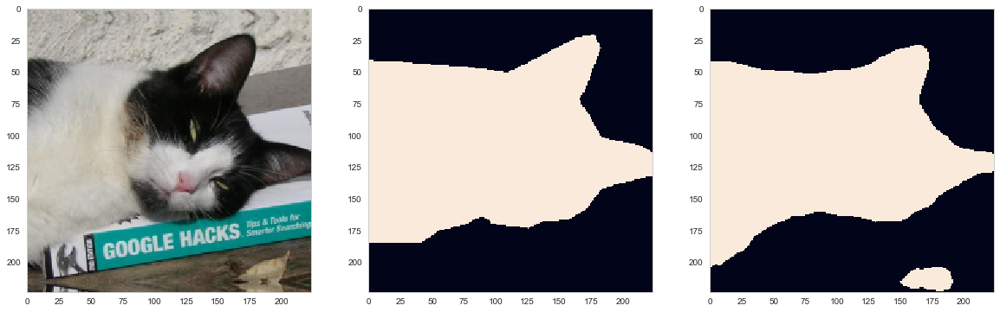

cat fpn_1.t7


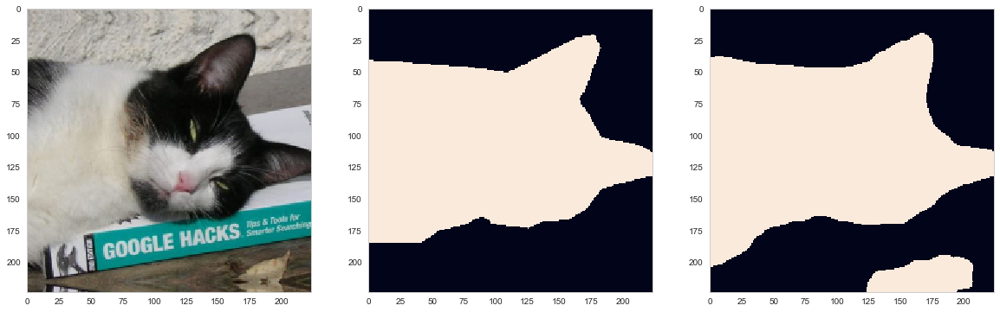

cat fpn_2.t7


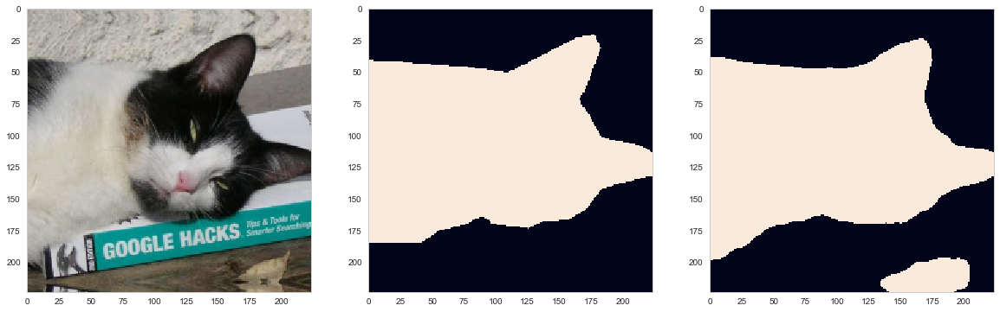

cat fpn_3.t7


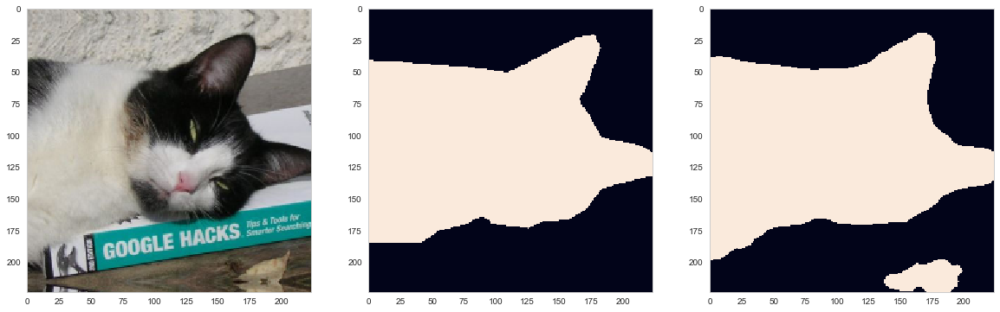

cat fpn_4.t7


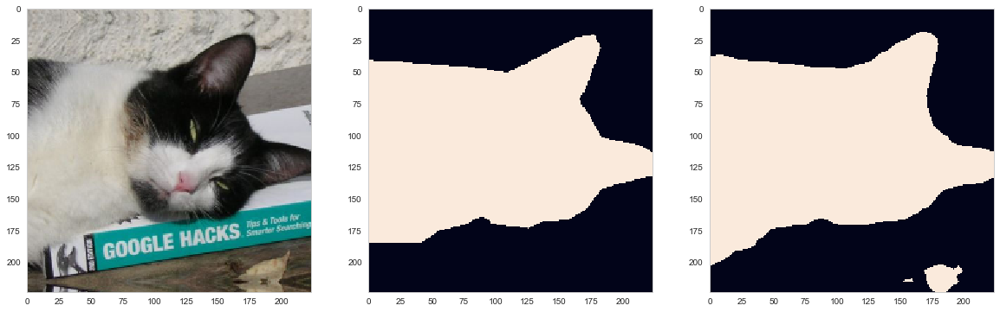

cat fpn_5.t7


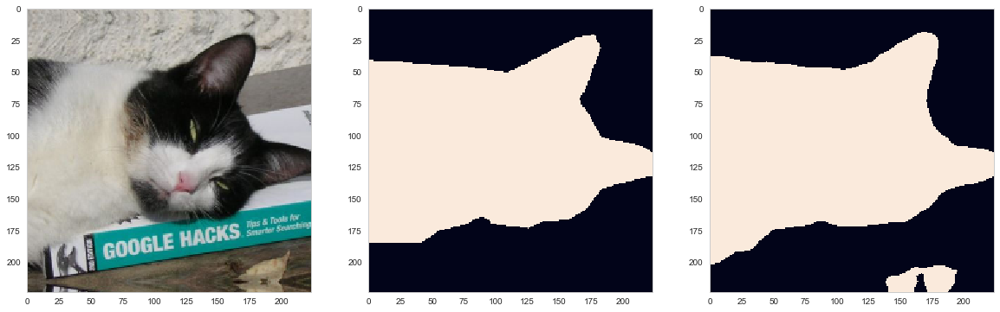

dog fpn_0.t7


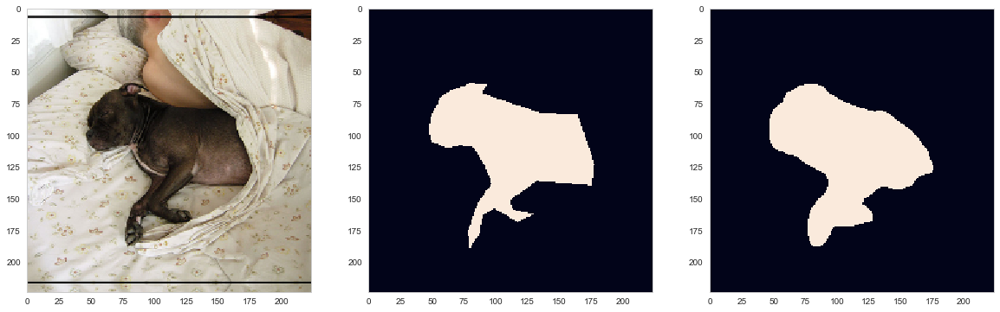

dog fpn_1.t7


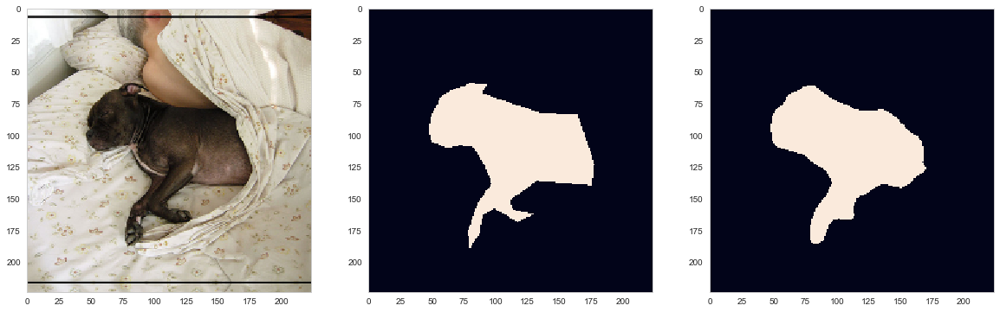

dog fpn_2.t7


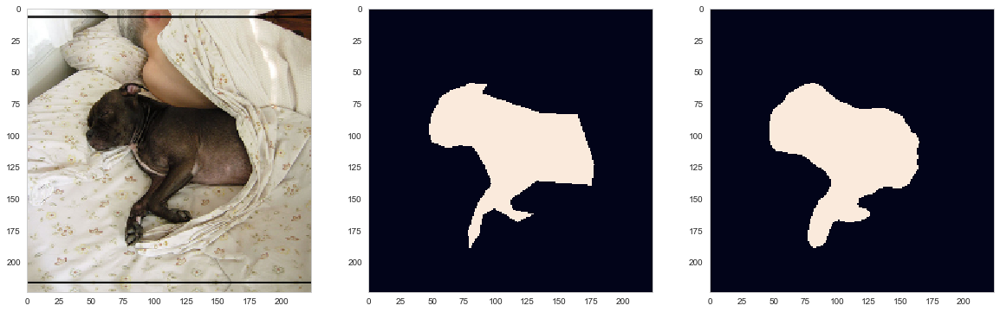

dog fpn_3.t7


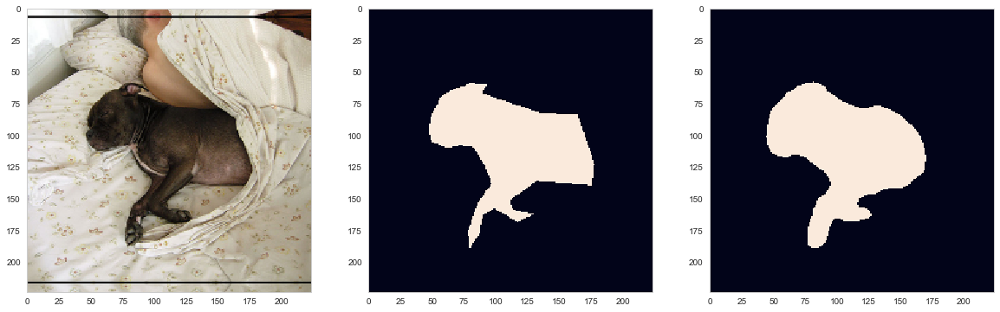

dog fpn_4.t7


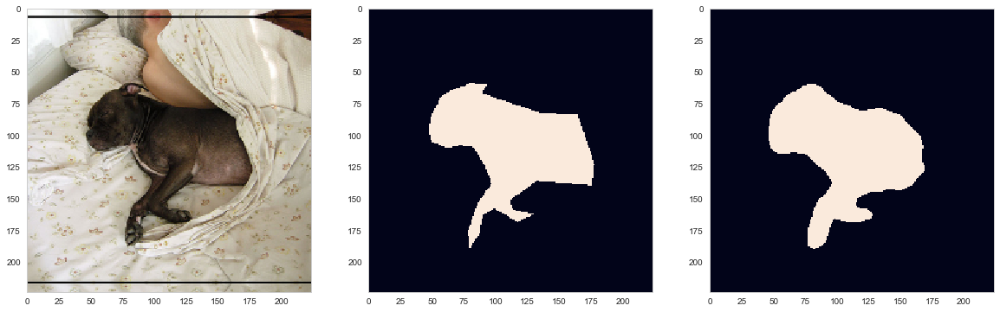

dog fpn_5.t7


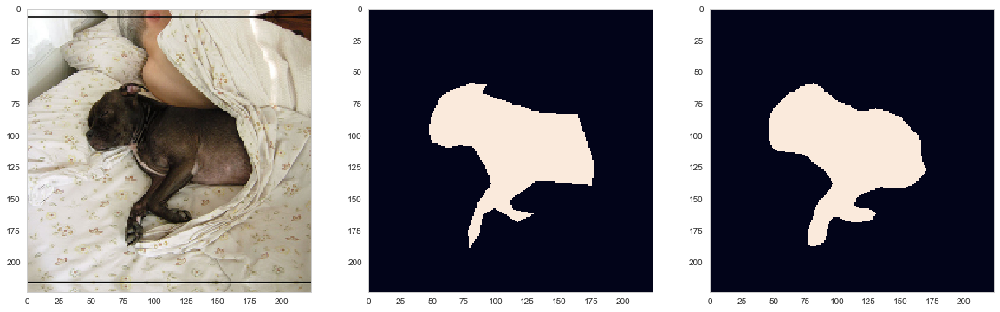

horse fpn_0.t7


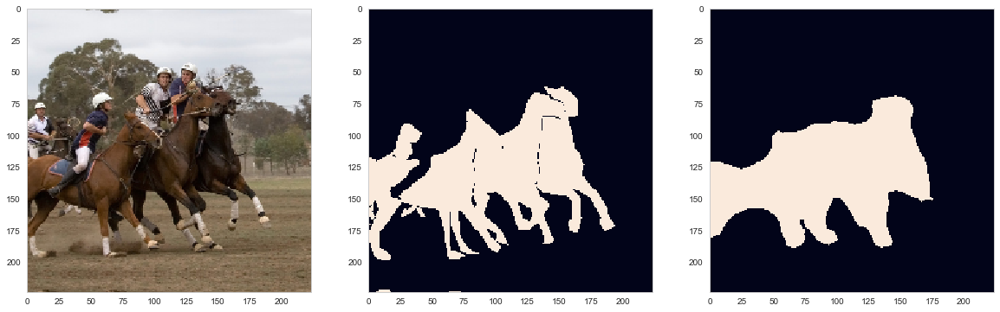

horse fpn_1.t7


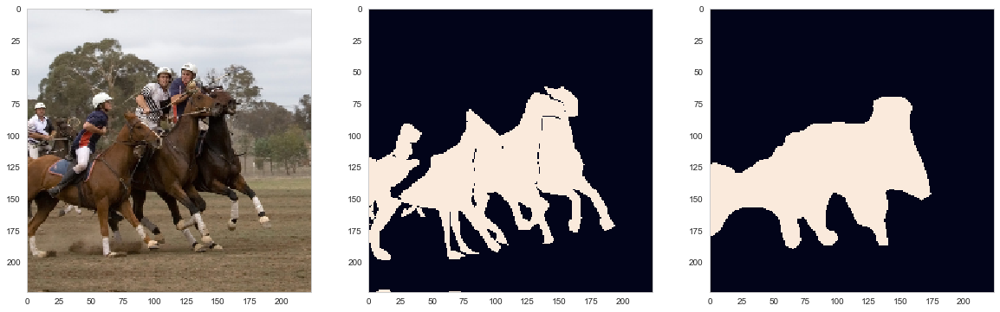

horse fpn_2.t7


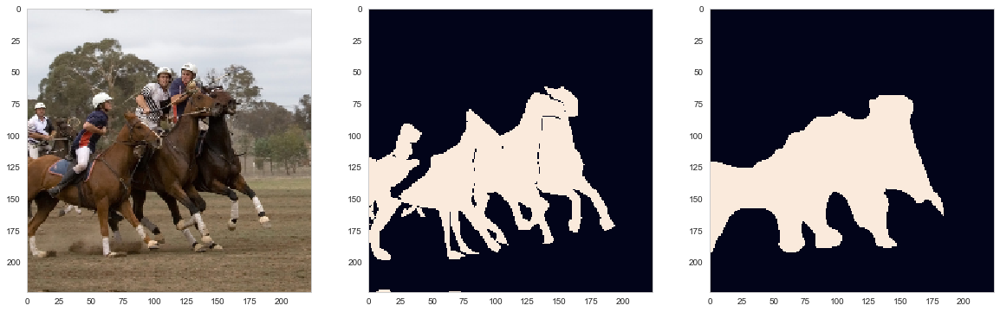

horse fpn_3.t7


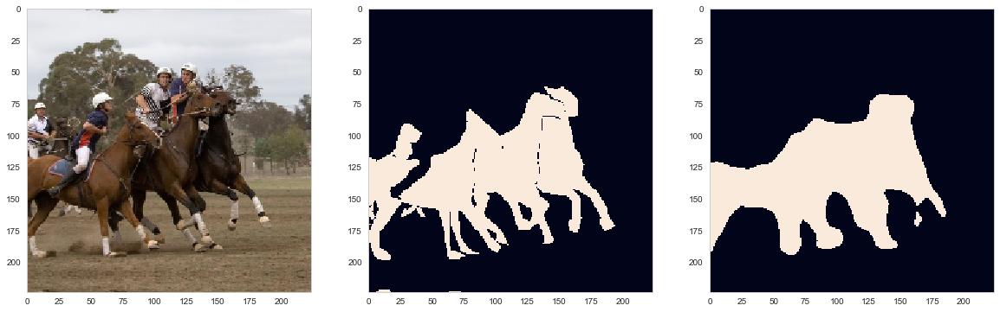

horse fpn_4.t7


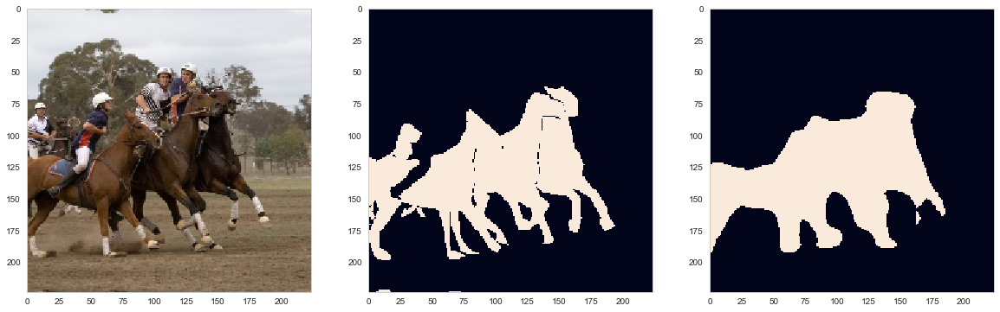

horse fpn_5.t7


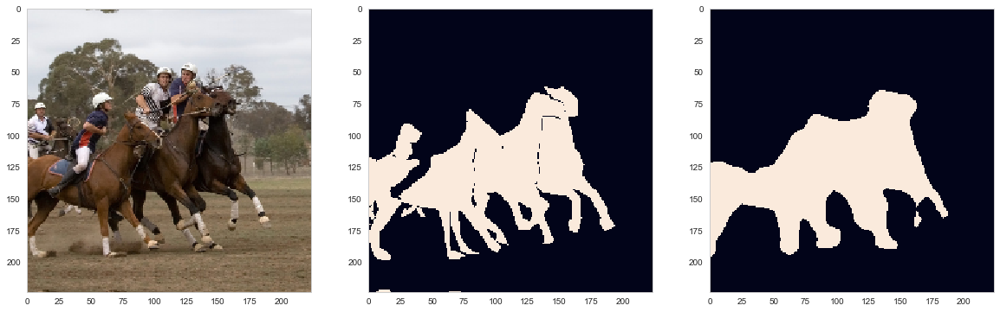

sheep fpn_0.t7


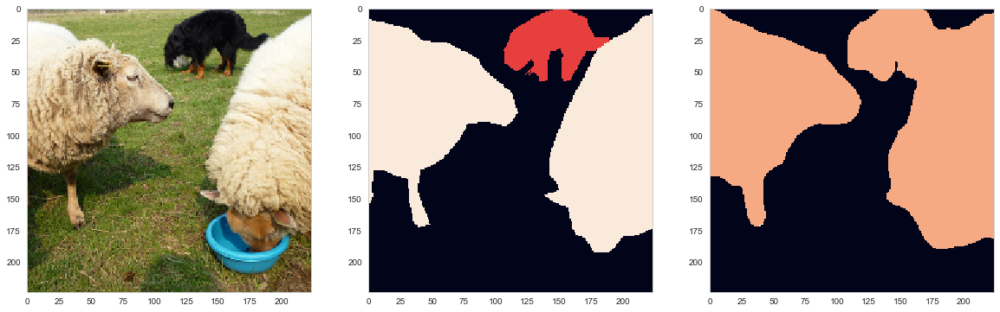

sheep fpn_1.t7


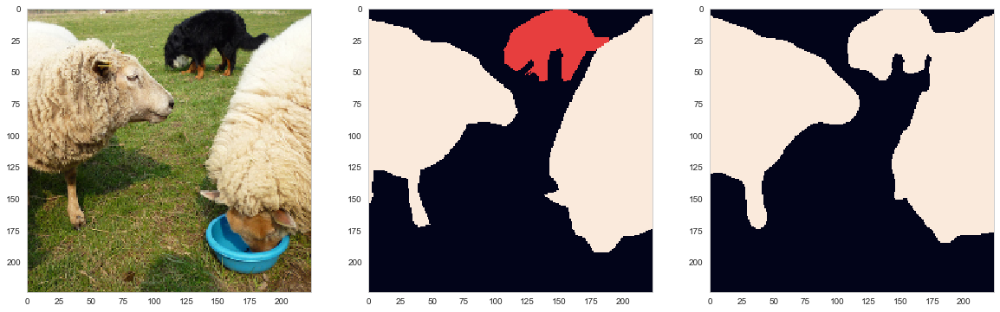

sheep fpn_2.t7


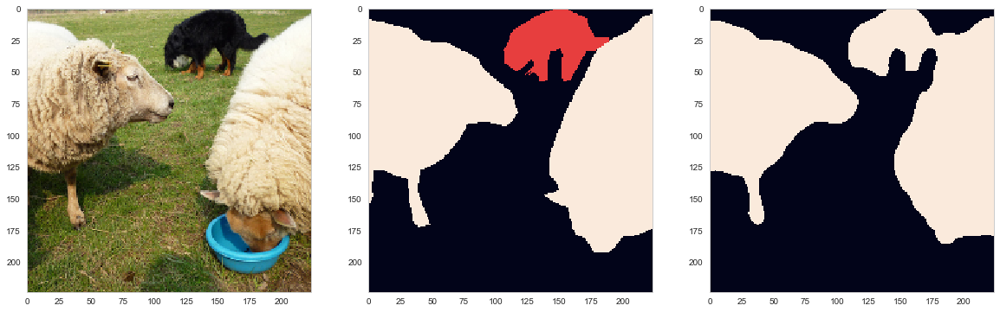

sheep fpn_3.t7


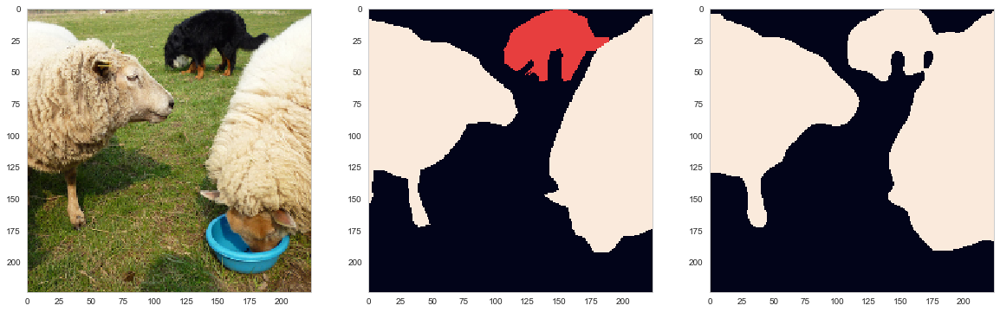

sheep fpn_4.t7


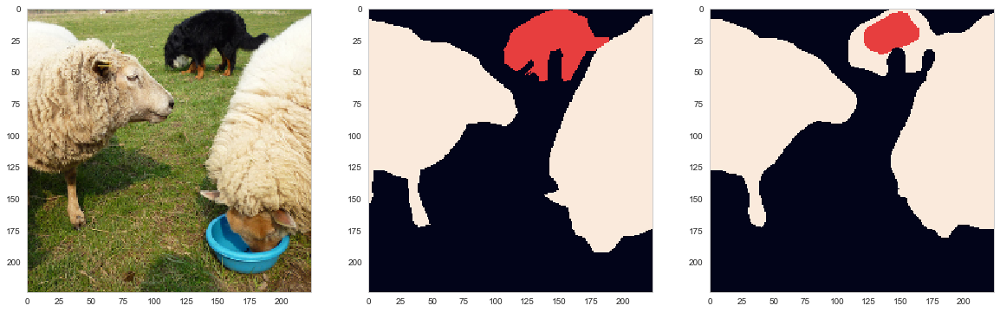

sheep fpn_5.t7


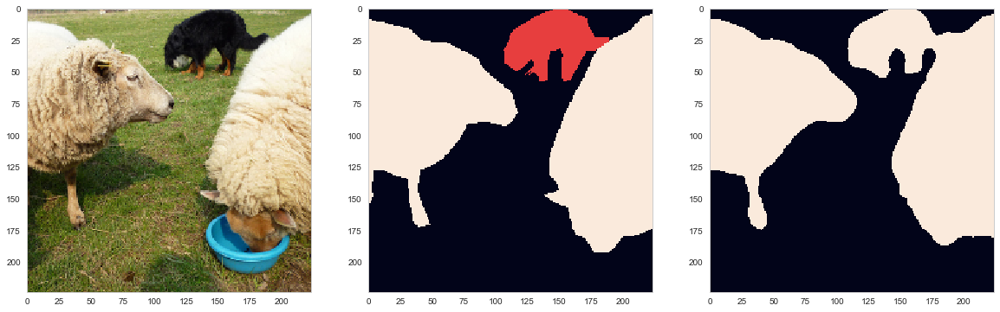

cow fpn_0.t7


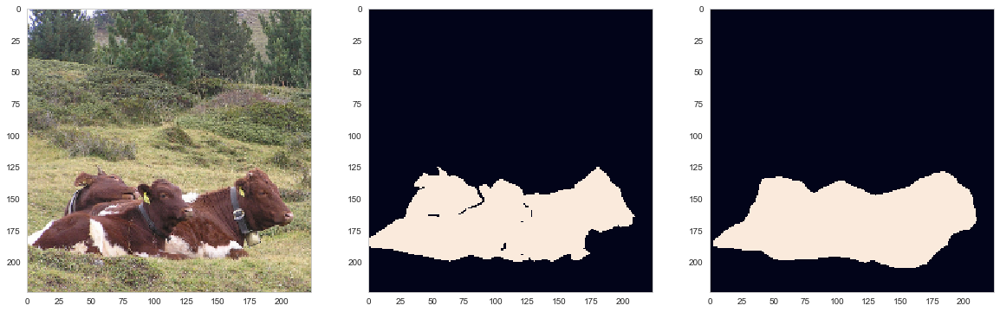

cow fpn_1.t7


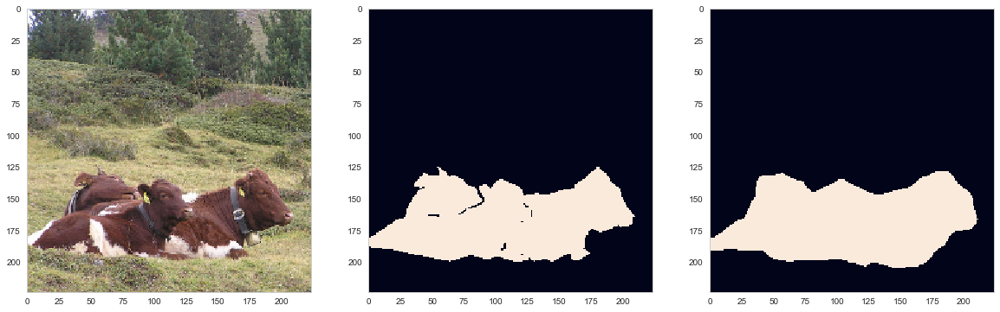

cow fpn_2.t7


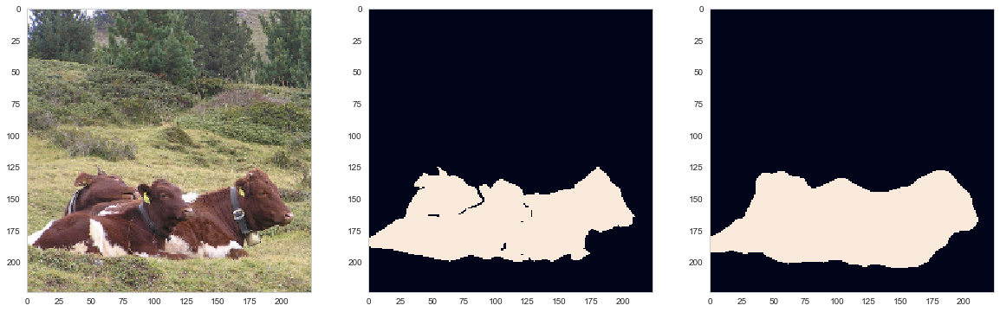

cow fpn_3.t7


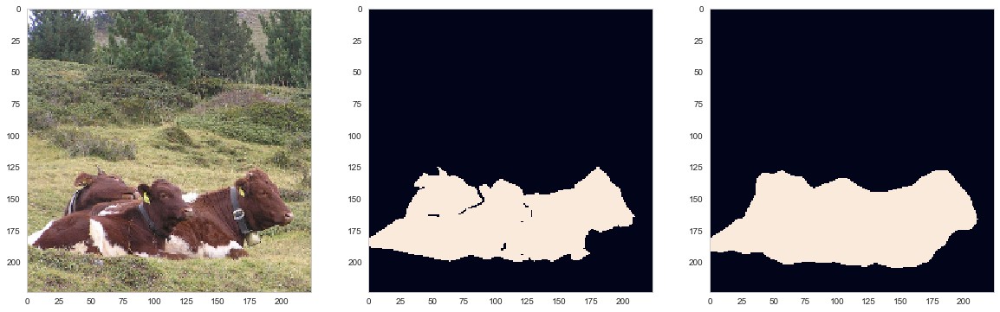

cow fpn_4.t7


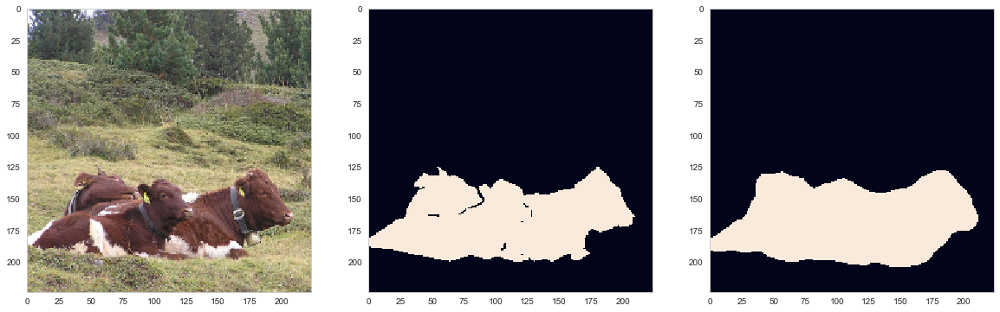

cow fpn_5.t7


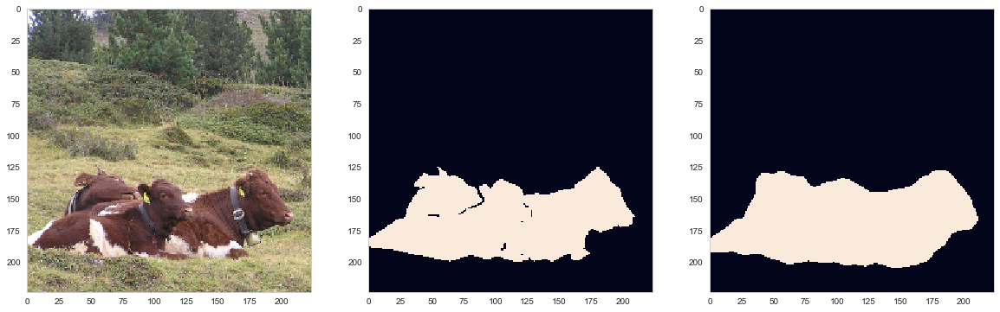

elephant fpn_0.t7


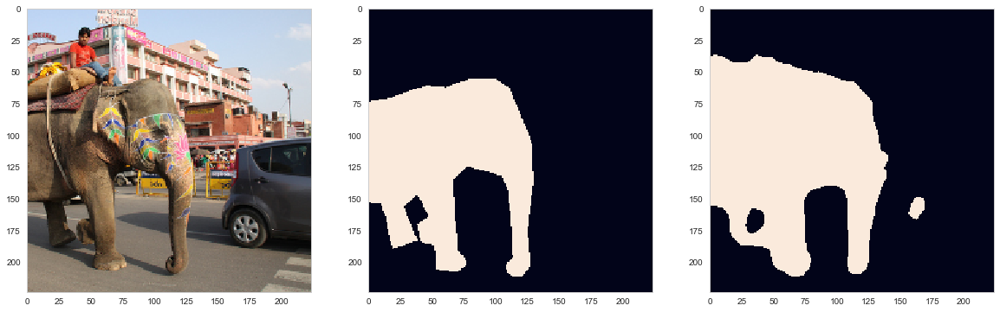

elephant fpn_1.t7


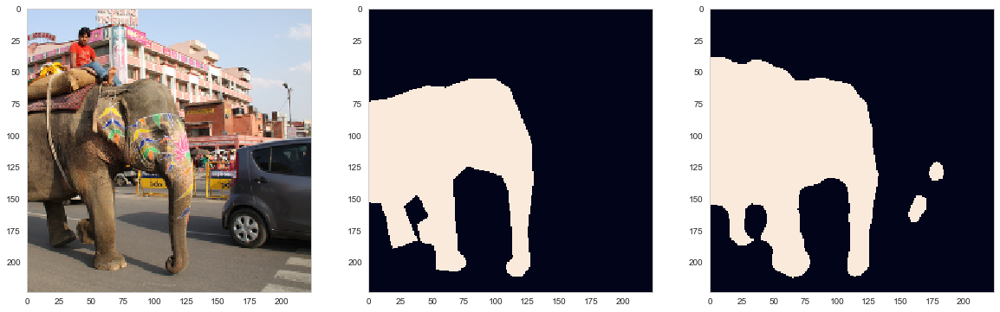

elephant fpn_2.t7


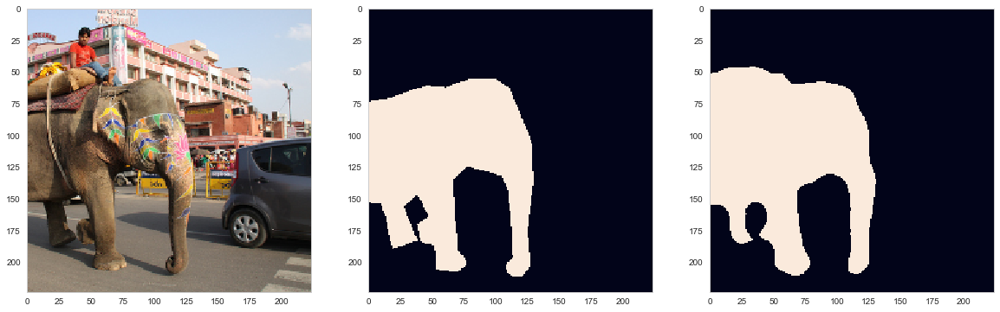

elephant fpn_3.t7


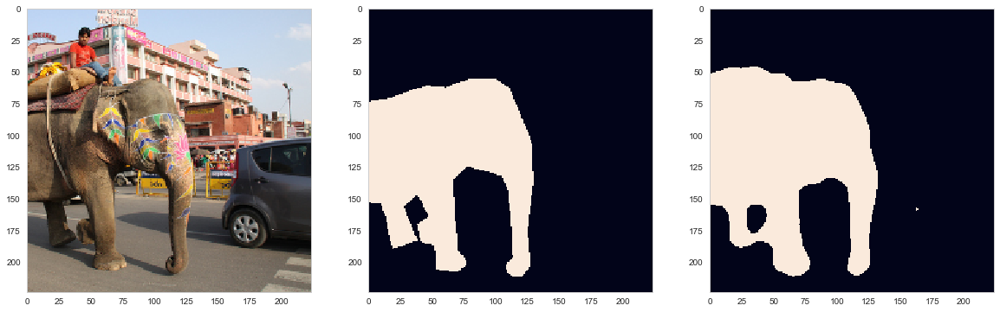

elephant fpn_4.t7


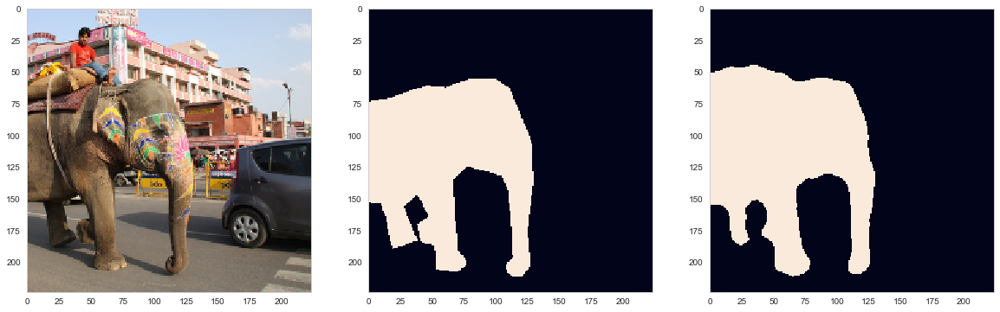

elephant fpn_5.t7


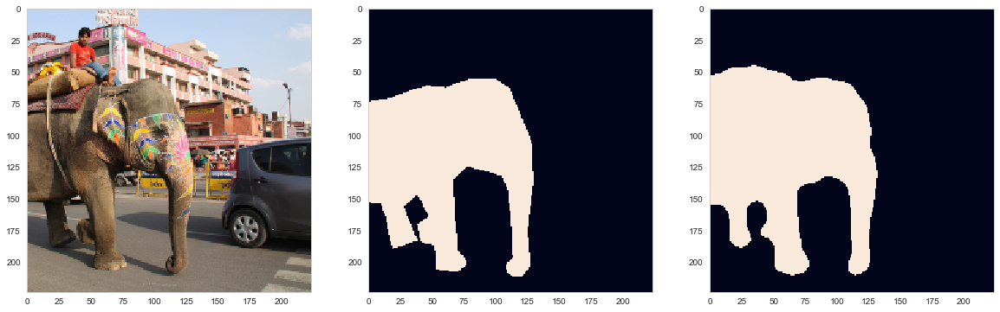

bear fpn_0.t7


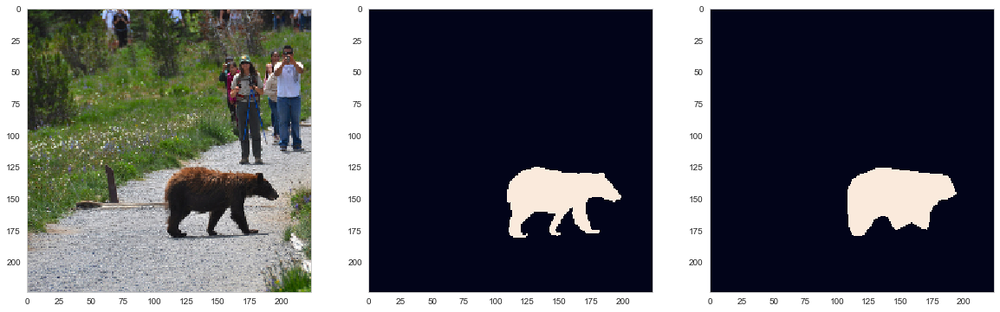

bear fpn_1.t7


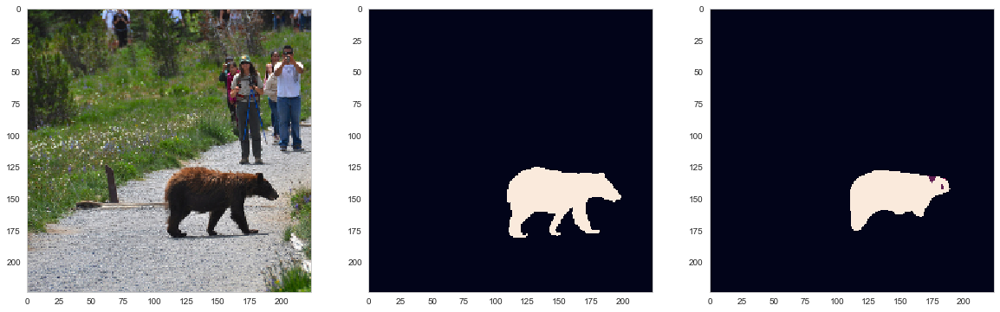

bear fpn_2.t7


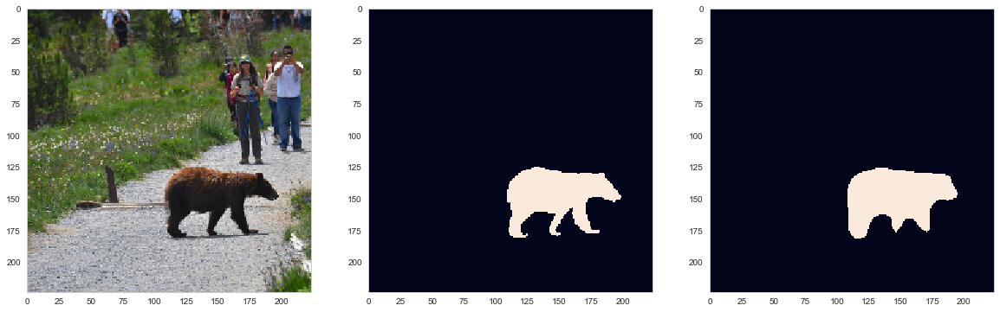

bear fpn_3.t7


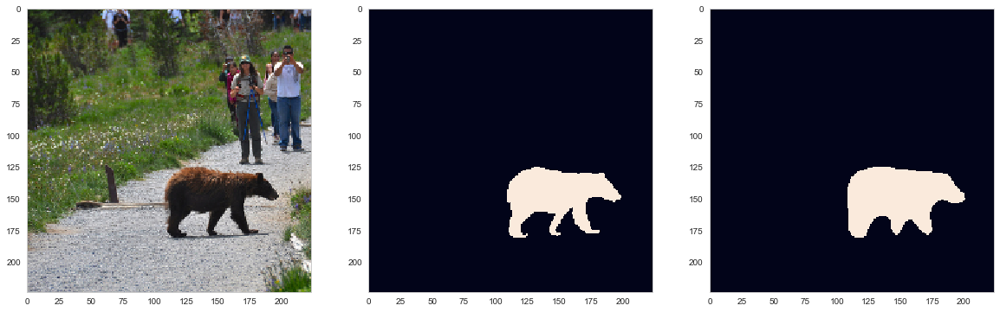

bear fpn_4.t7


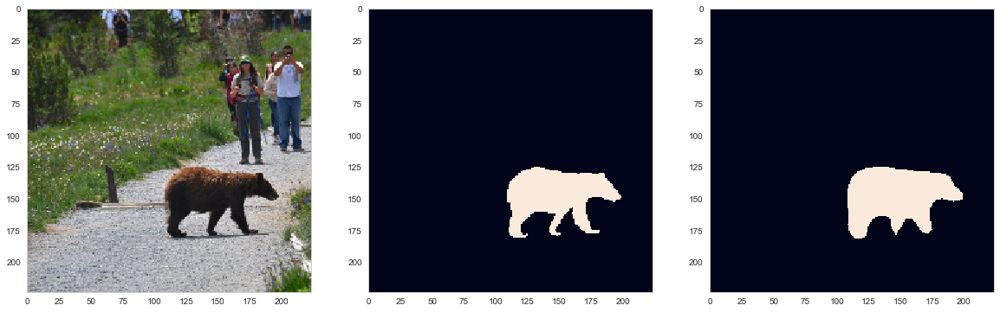

bear fpn_5.t7


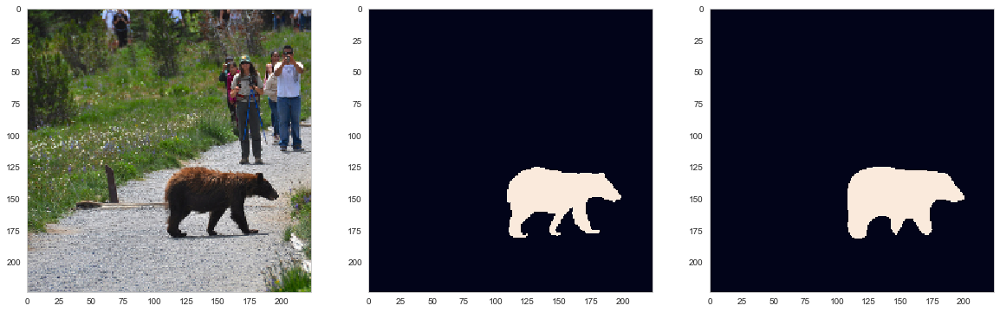

zebra fpn_0.t7


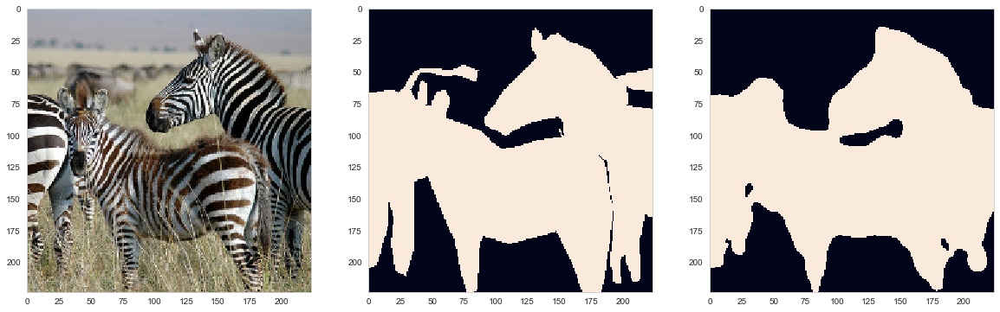

zebra fpn_1.t7


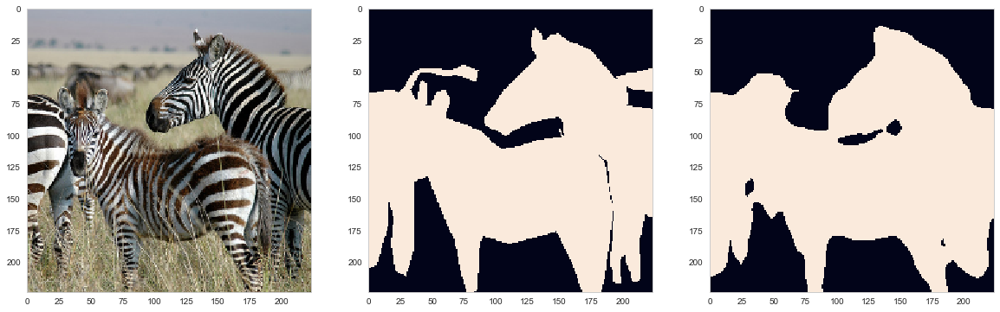

zebra fpn_2.t7


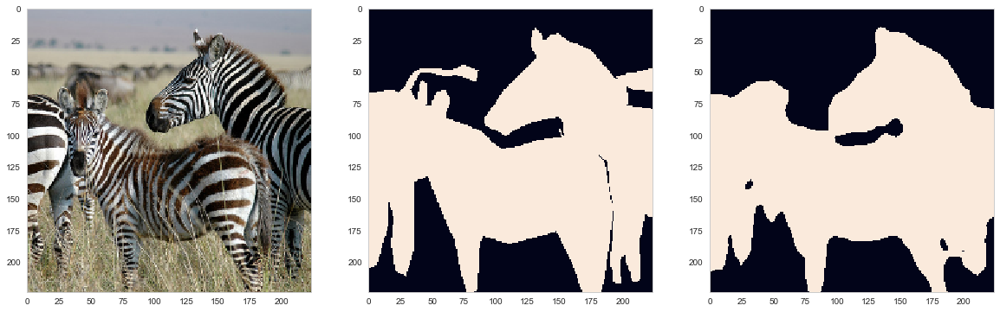

zebra fpn_3.t7


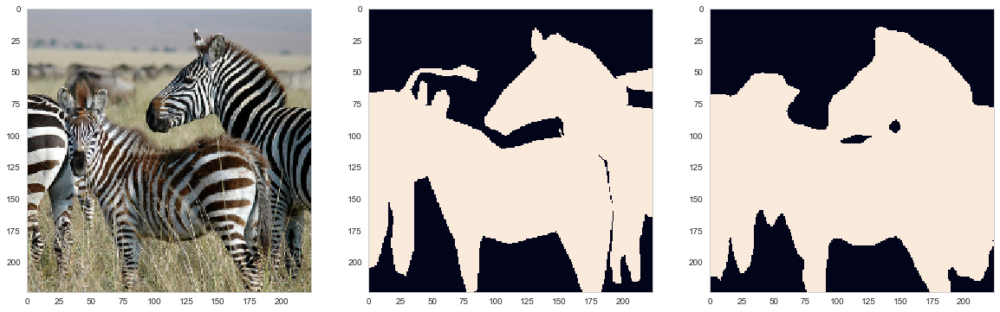

zebra fpn_4.t7


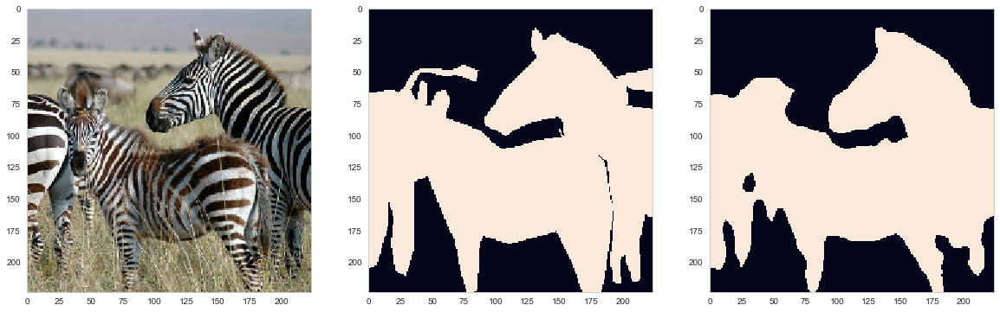

zebra fpn_5.t7


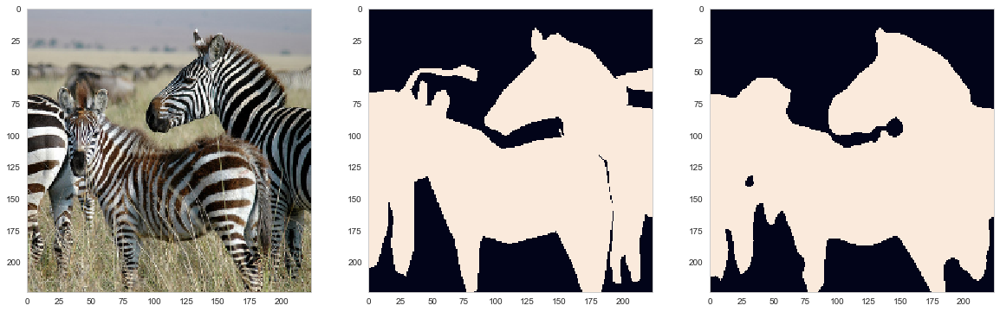

giraffe fpn_0.t7


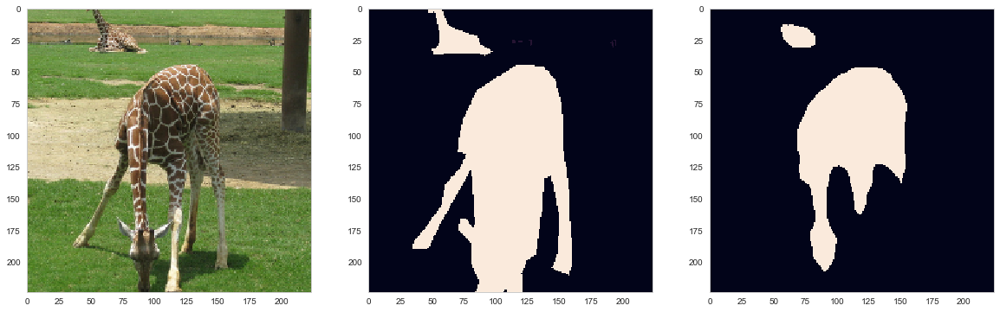

giraffe fpn_1.t7


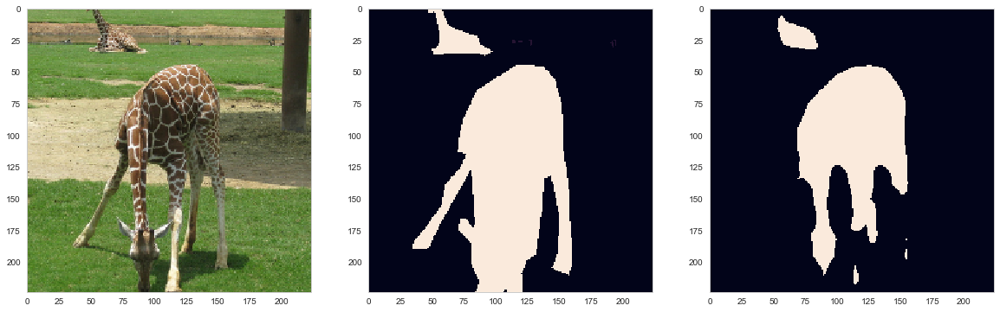

giraffe fpn_2.t7


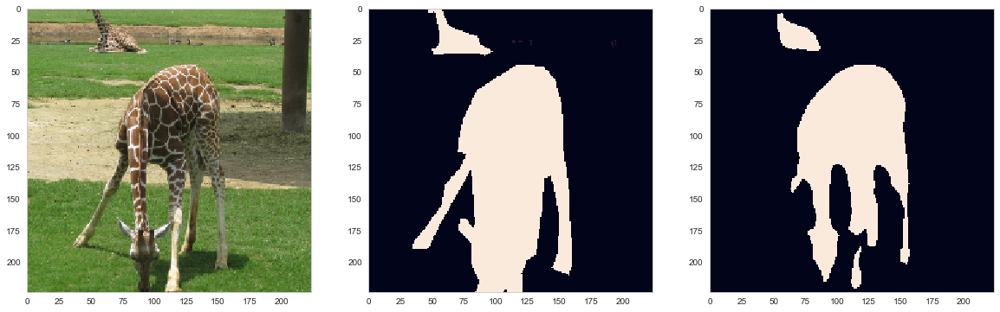

giraffe fpn_3.t7


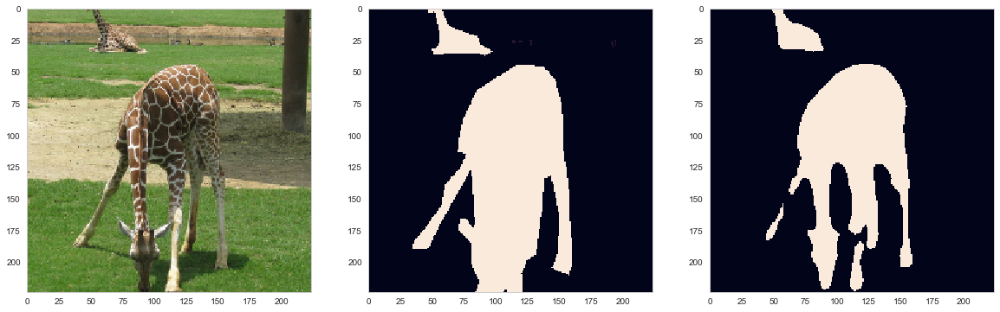

giraffe fpn_4.t7


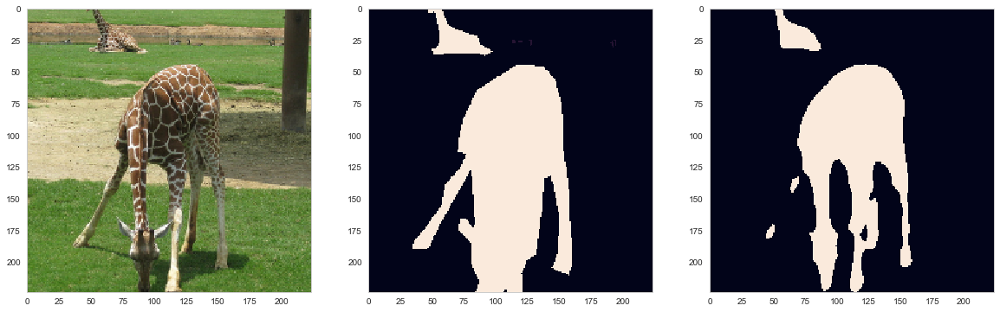

giraffe fpn_5.t7


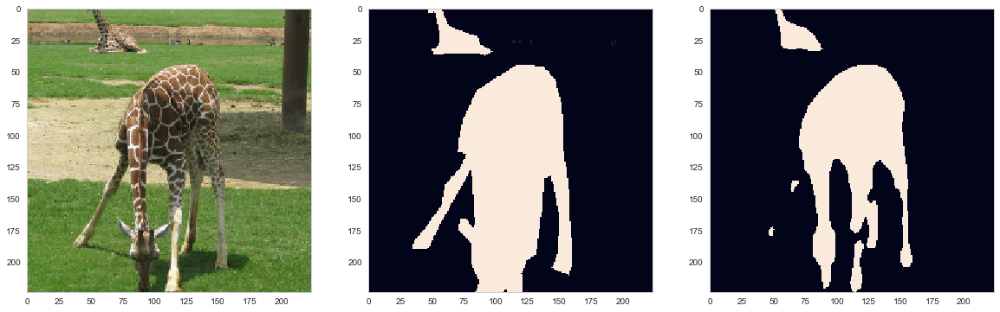

difficult fpn_0.t7


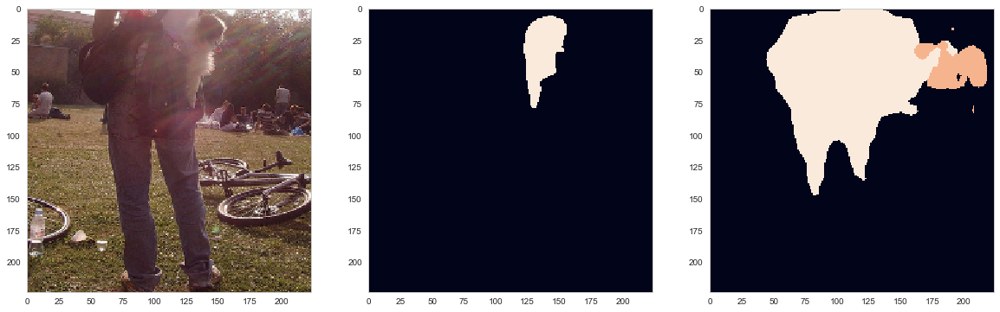

difficult fpn_1.t7


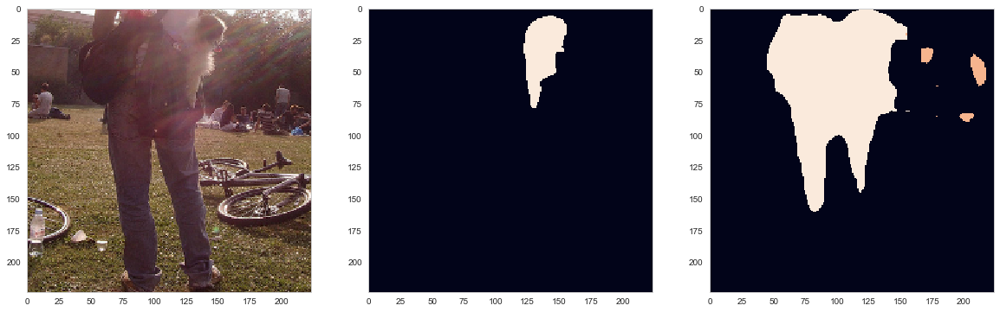

difficult fpn_2.t7


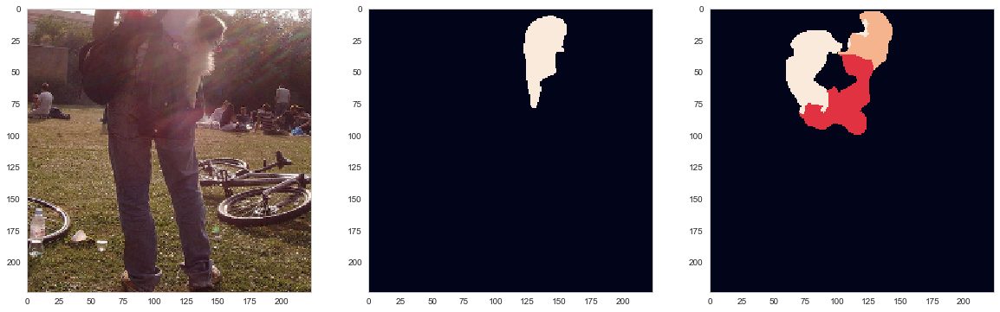

difficult fpn_3.t7


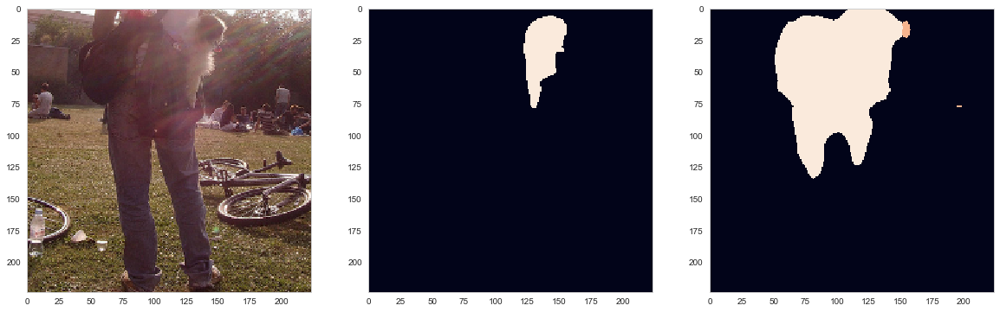

difficult fpn_4.t7


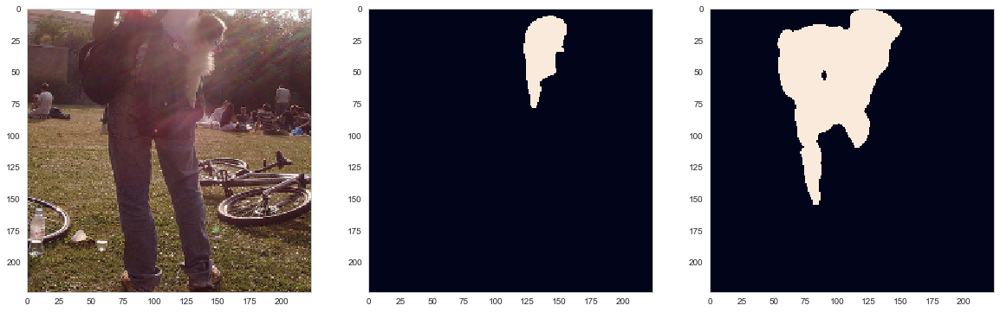

difficult fpn_5.t7


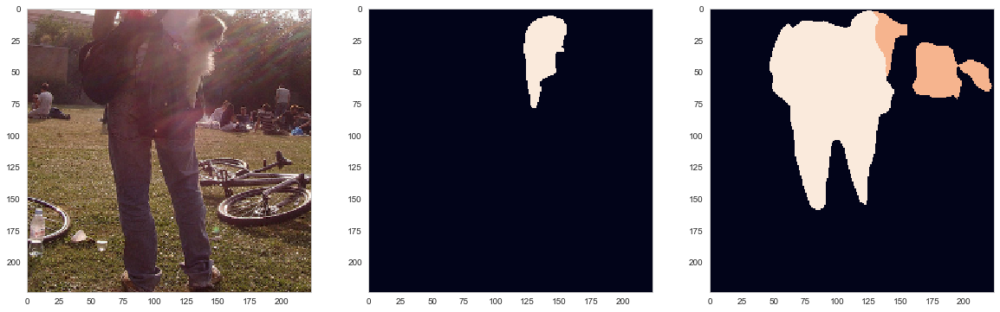

difficult fpn_0.t7


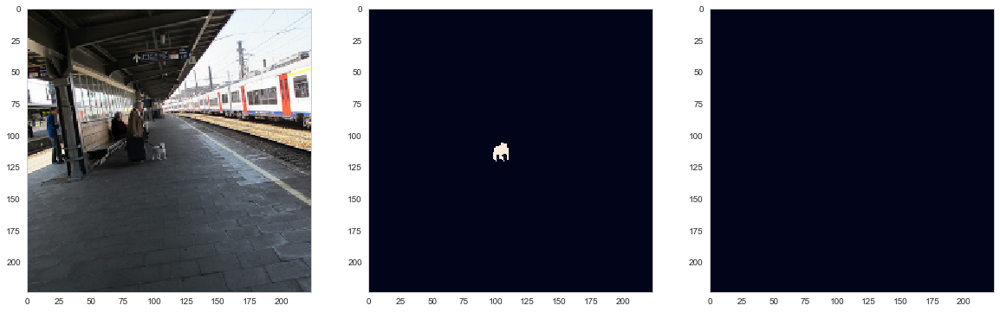

difficult fpn_1.t7


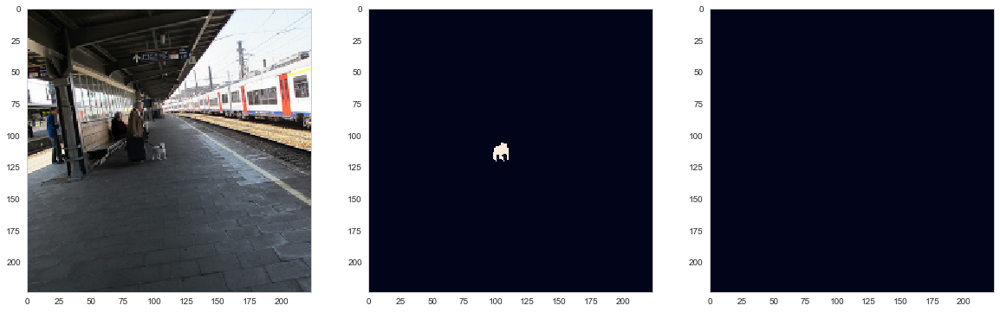

difficult fpn_2.t7


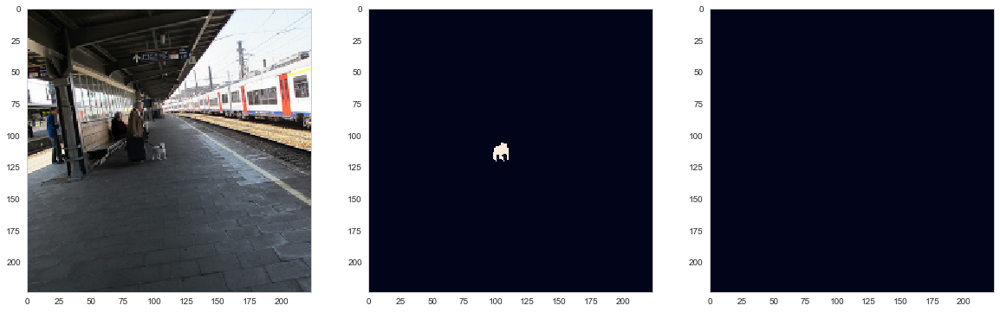

difficult fpn_3.t7


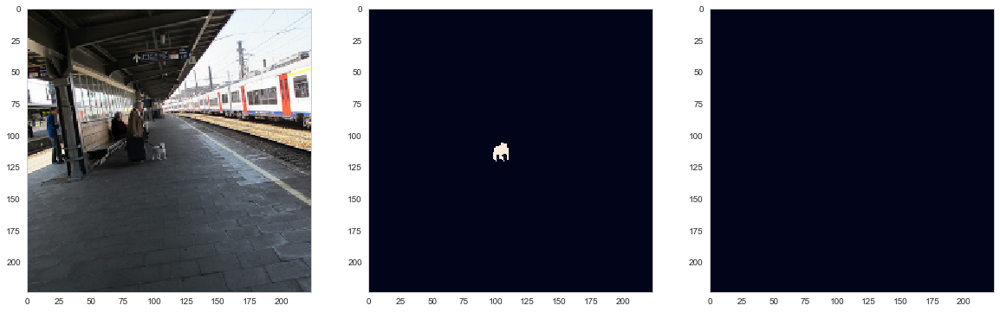

difficult fpn_4.t7


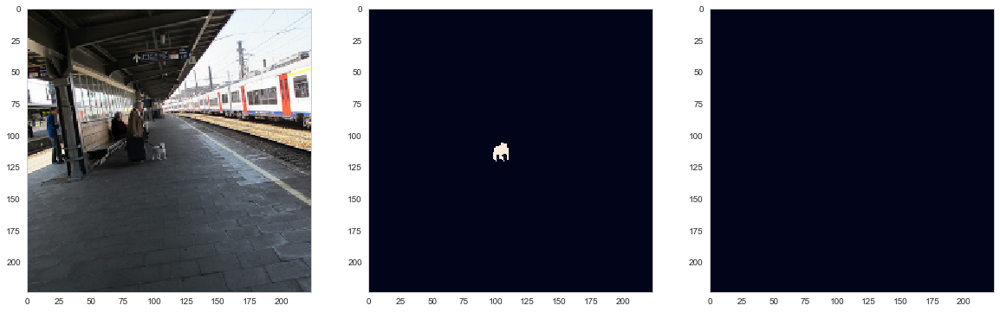

difficult fpn_5.t7


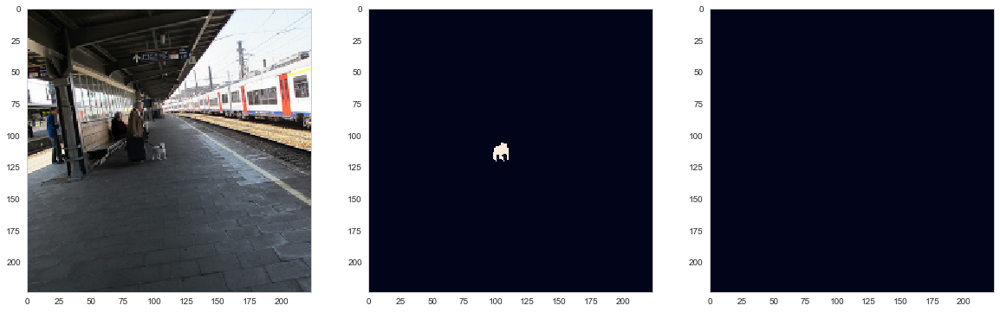

multiple classes fpn_0.t7


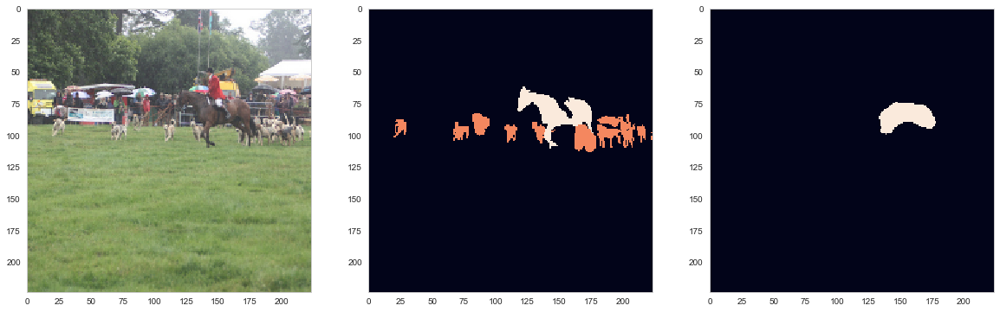

multiple classes fpn_1.t7


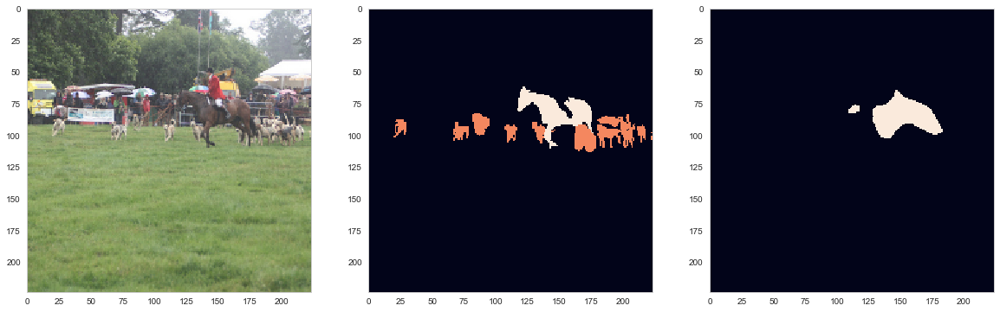

multiple classes fpn_2.t7


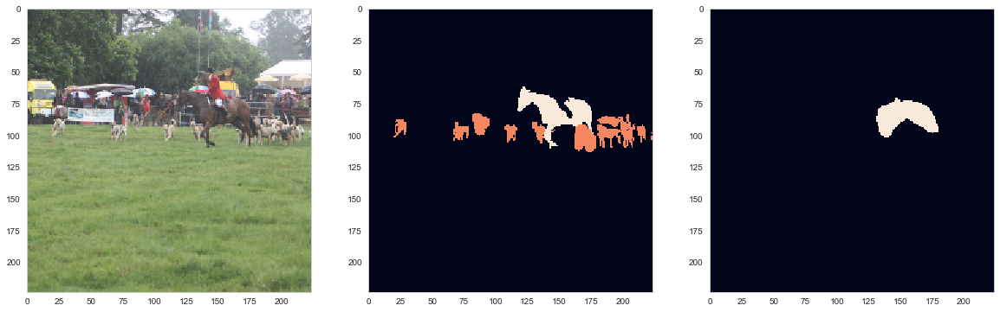

multiple classes fpn_3.t7


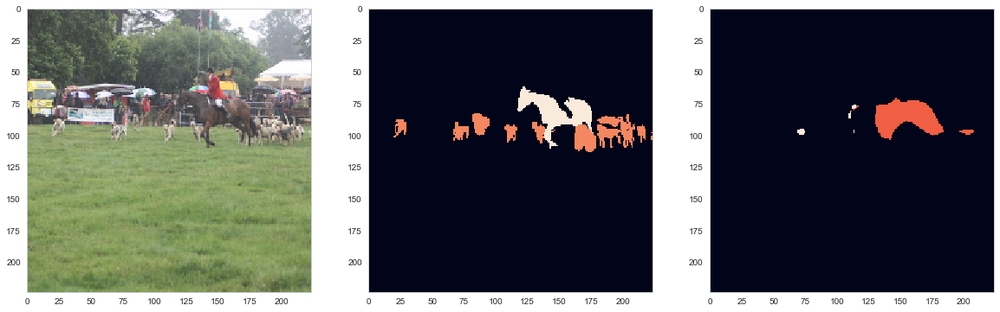

multiple classes fpn_4.t7


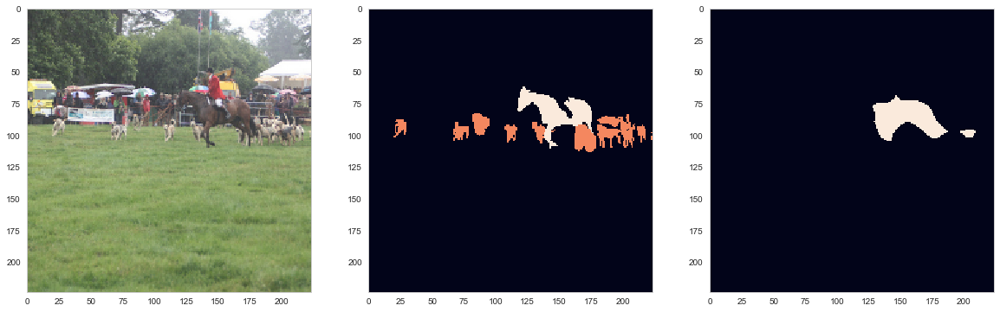

multiple classes fpn_5.t7


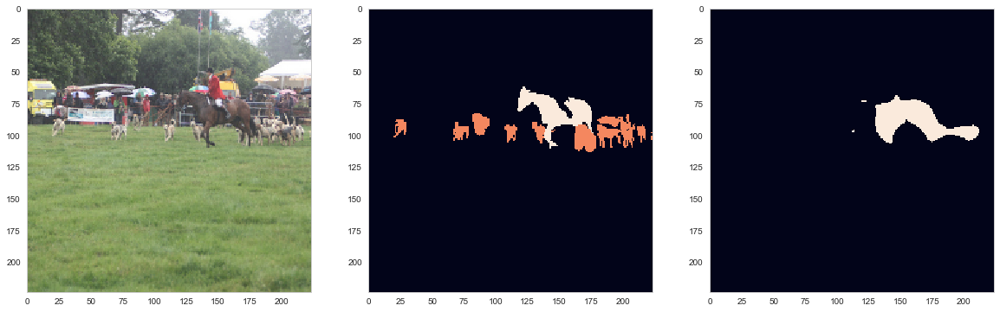

multiple classes fpn_0.t7


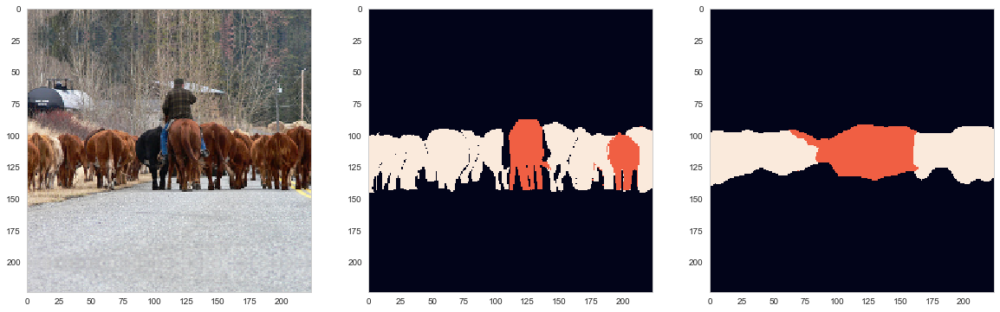

multiple classes fpn_1.t7


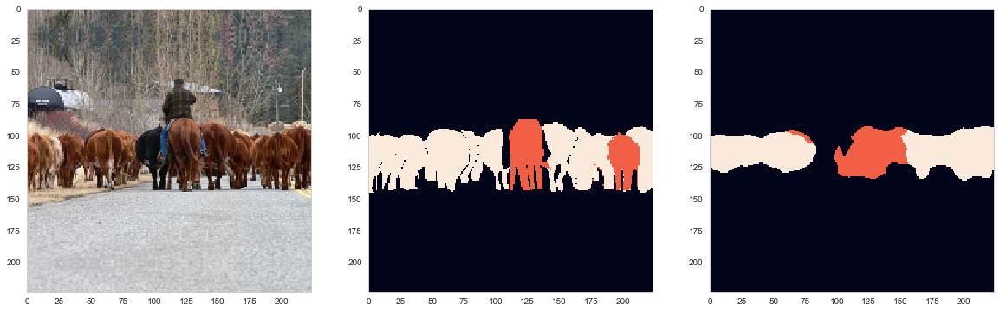

multiple classes fpn_2.t7


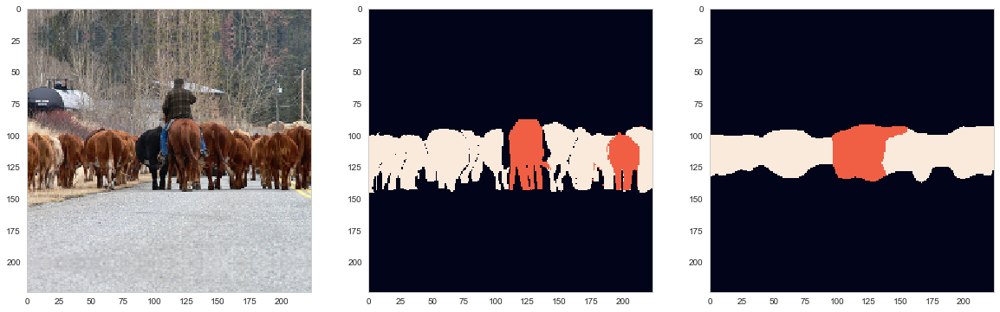

multiple classes fpn_3.t7


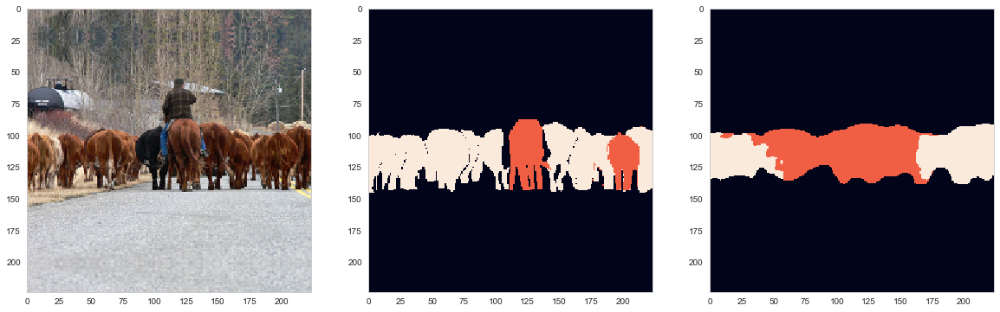

multiple classes fpn_4.t7


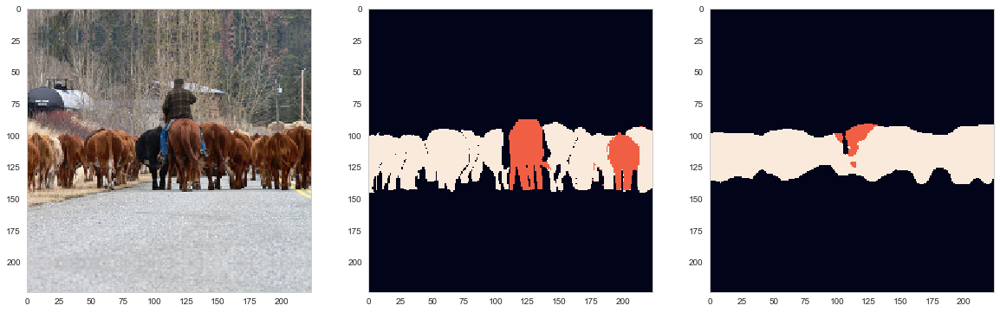

multiple classes fpn_5.t7


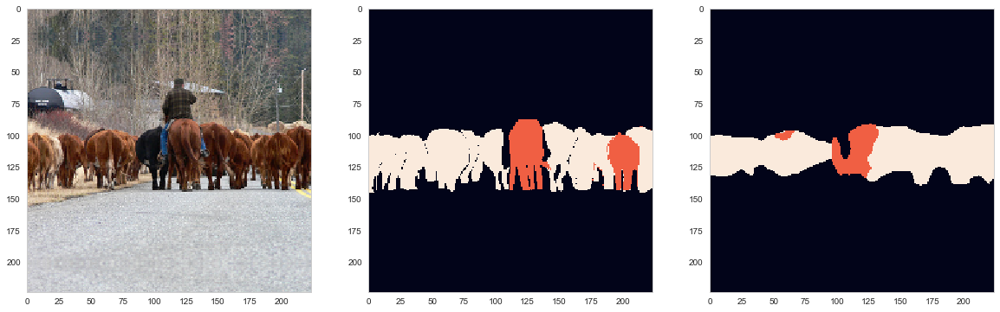

multiple classes fpn_0.t7


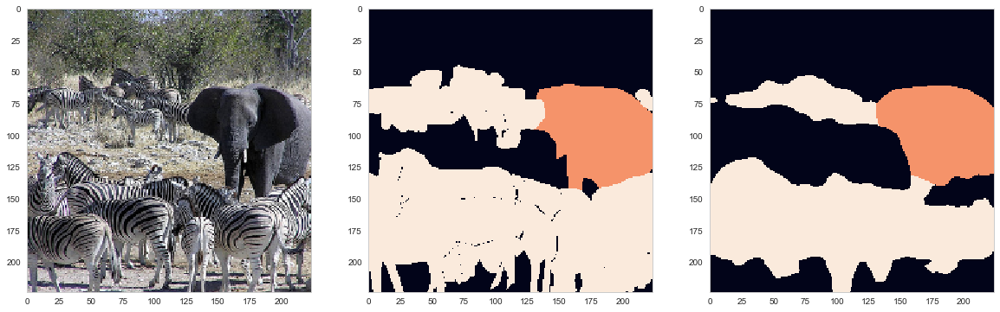

multiple classes fpn_1.t7


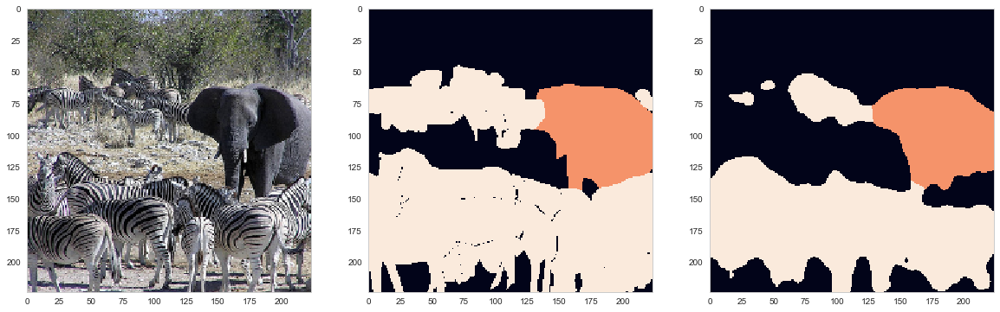

multiple classes fpn_2.t7


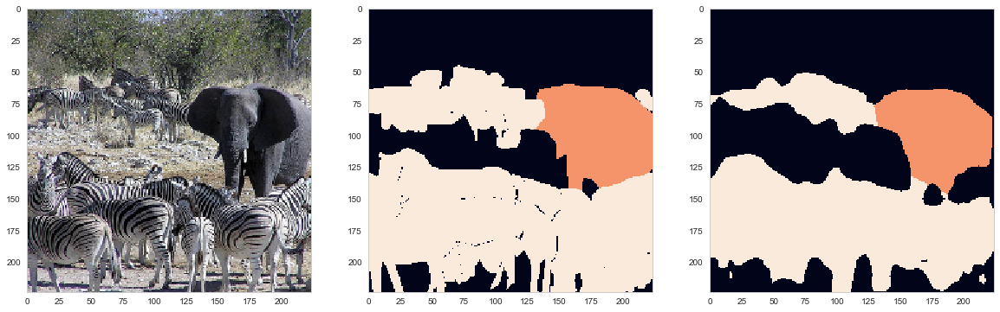

multiple classes fpn_3.t7


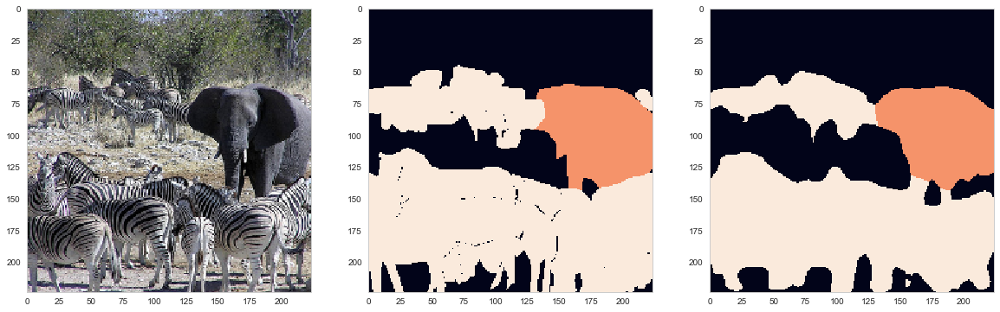

multiple classes fpn_4.t7


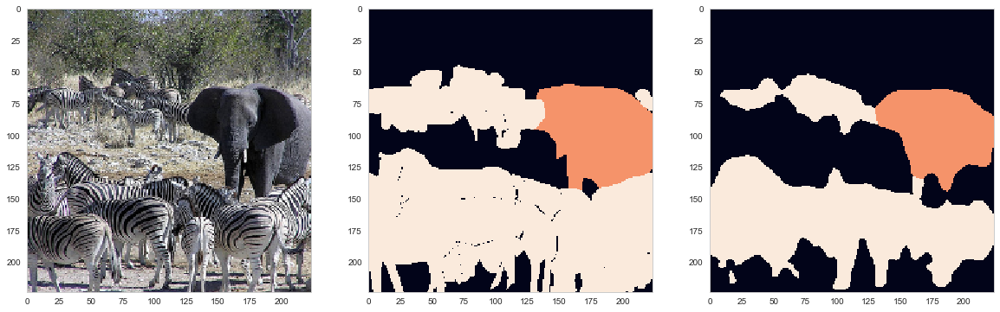

multiple classes fpn_5.t7


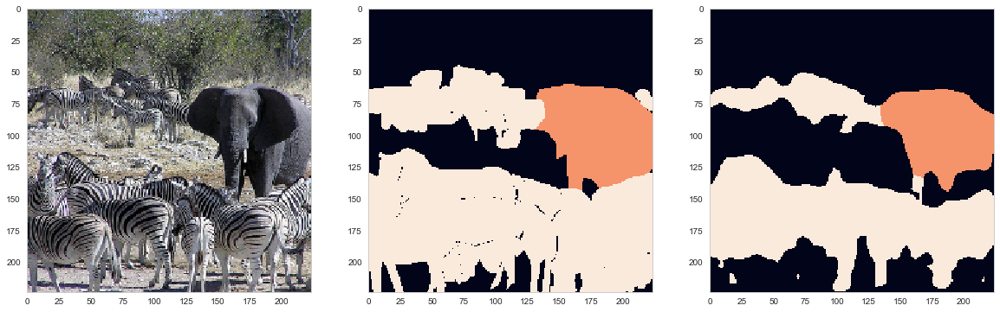

In [42]:
for k, v in examples.items():
    plot_val_model(k, v, fpn_models)

# Прогресс FCN

In [ ]:
for k, v in examples.items():
    plot_val_model(k, v, fcn_models)

# Сравнение FPN и FCN

In [ ]:
def plot_val_model_compr(i, title, fpn_mdl, fcn_mdl):
    img, msk, _ = valid_dataset[i]
    sm = nn.Softmax(dim=1)
    
    fcn_pred = sm(fcn_mdl[1](img.expand(1, -1,-1,-1).to(device)))
    _, fcn_max_pred = torch.max(fcn_pred, dim=1)
    
    fpn_pred = sm(fpn_mdl[1](img.expand(1, -1,-1,-1).to(device)))
    _, fpn_max_pred = torch.max(fpn_pred, dim=1)
    
    print(title, fpn_mdl[0], fcn_mdl[0])
    plt.figure(figsize=(20,10))
    plt.subplot(141)
    plt.imshow(img.numpy().transpose((1,2,0)))
    plt.subplot(142)
    plt.imshow(np.squeeze(msk.numpy()))
    plt.subplot(143)
    plt.imshow(fpn_max_pred[0].detach().cpu().numpy())
    plt.subplot(144)
    plt.imshow(fcn_max_pred[0].detach().cpu().numpy())
    plt.pause(0.1)

In [ ]:
for k, v in examples.items():
    plot_val_model_compr(k, v, fpn_models[-1], fpn_models[-1])

# EXTRA: Прогресс FCN на 81 классе

In [ ]:
class Dataset(CocoDetection):
    def __init__(self, root, annFile, transforms=None, transform=None, target_transform=None):
        super().__init__(root, annFile, transforms, transform, target_transform)
        
#         self.coco_cats = ['__background__', 'airplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
#                      'car', 'cat', 'chair', 'cow', 'dining table', 'dog', 'horse', 'motorcycle',
#                      'person', 'potted plant', 'sheep', 'couch', 'train', 'tv']
#         cats = self.coco.loadCats(self.coco.getCatIds(catNms=self.coco_cats))
        cats = self.coco.loadCats(self.coco.getCatIds())
        self.id_to_class, self.layer_to_name, self.layer_to_cat = {}, {}, {}
        self.id_to_class[0] = 0
        self.layer_to_name[0] = 'background'
        for it, cat in enumerate(cats):
            self.id_to_class[cat['id']] = it+1
            self.layer_to_name[it+1] = cat['name']
            self.layer_to_cat[cat['id']] = cat['name']
        
    def to_one_hot(self, tensor, nClasses):
        n,h,w = tensor.size()
        one_hot = torch.zeros(n,nClasses,h,w).scatter_(1,tensor.view(n,1,h,w),1)
        return one_hot
        
    def __getitem__(self, index):
        img, ann = super().__getitem__(index)
        width, height = img.size[:2]
        msk = np.zeros((height, width))
        
        padding=(
                    320-int(width /2) if width  % 2 == 0 else 320-int(width /2)-1,
                    320-int(height /2) if height  % 2 == 0 else 320-int(height /2)-1,
                    320-int(width /2),
                    320-int(height/2)
                )
        
        img_T = transforms.Compose(([
            transforms.Pad(padding),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
        ]))
        
        msk_T = transforms.Compose(([
            transforms.ToPILImage(),
            transforms.Pad(padding),
            transforms.ToTensor()
        ]))
        
        categories = set()

        imgid=0
        
        for it in sorted(ann, key=lambda x: self.id_to_class[x['category_id']]):
            imgid=int(it['image_id'])
            if it['category_id'] in self.id_to_class:
                compressed_rle = mask.frPyObjects(it['segmentation'], height, width)
                compressed_rle = compressed_rle if isinstance(compressed_rle, list) else [compressed_rle]
                bw = np.sum(mask.decode(compressed_rle), axis = 2).astype(bool)
                msk[bw] = self.id_to_class[it['category_id']]
                categories.add(self.layer_to_cat[it['category_id']])
        msk=msk_T(msk.astype(int)).long()
        
        return img_T(img), msk, self.to_one_hot(msk, len(self.id_to_class)), list(categories), imgid

In [ ]:
dataDir = '../../../COCO'
valDataType = "val2017"
valAnnFile = "{}/annotations/instances_{}.json".format(dataDir,valDataType)

In [ ]:
val_set = Dataset(valDataType, valAnnFile)

In [ ]:
fcn_models_81=[]

for file in ['semantic_1_27800.pt','semantic_1_55000.pt','semantic_2_59144.pt', 'semantic_3_59144.pt']:
    fcn_1=torch.load('../../../COCO/snapshots/'+file).to(device)
    fcn_1.eval()
    
    fcn_models_81.append([file,fcn_1])

In [ ]:
def rescale(img):
    return (1/(2.64*2.1179)) * img + 0.5

In [ ]:
def plot_val_model_81(i, mdls):
    img, msk, label, cats, imgid = val_set[i]
    sm = nn.Softmax(dim=1)
    for mdl in mdls:
        print(mdl[0])
        pred = sm(mdl[1](img.expand(1, -1,-1,-1).to(device)))
        _, max_pred = torch.max(pred, dim=1)
        plt.figure(figsize=(20,10))
        plt.subplot(131)
        plt.imshow(rescale(img).numpy().transpose((1,2,0)))
        plt.subplot(132)
        plt.imshow(np.squeeze(msk.numpy()))
        plt.subplot(133)
        plt.imshow(max_pred[0].detach().cpu().numpy())
        plt.pause(0.1)

In [ ]:
os.chdir(dataDir)

In [ ]:
for i in range(10):
    plot_val_model_81(i, fcn_models_81)